

> ### The Mountain Car

> This section will demonstrate how Q-Learning can create a solution to the mountain car gym environment. The Mountain car is an environment where a car must climb a mountain. Because gravity is stronger than the car's engine, it cannot merely accelerate up the steep slope even with full throttle. The vehicle is situated in a valley and must learn to utilize potential energy by driving up the opposite hill before the car can make it to the goal at the top of the rightmost hill.



> The mountain car environment provides the following discrete actions:

> * 0 - Apply left force
* 1 - Apply no force
* 2 - Apply right force

> The mountain car environment is made up of the following continuous values:

> * state[0] - Position 
* state[1] - Velocity


> # Deep Q-Network

> The  [DQN algorithm](https://storage.googleapis.com/deepmind-media/dqn/DQNNaturePaper.pdf) was developed by DeepMind in 2015. It was able to solve a wide range of Atari games (some to superhuman level) by combining reinforcement learning and deep neural networks at scale. The algorithm was developed by enhancing a classic RL algorithm called Q-Learning with deep neural networks and a technique called *experience replay*.

> ### DQN algorithm

> Our environment is deterministic, so all equations presented here are
also formulated deterministically for the sake of simplicity. In the
reinforcement learning literature, they would also contain expectations
over stochastic transitions in the environment.

> Our aim will be to train a policy that tries to maximize the discounted,
cumulative reward
$R_{t_0} = \sum_{t=t_0}^{\infty} \gamma^{t - t_0} r_t$, where
$R_{t_0}$ is also known as the *return*. The discount,
$\gamma$, should be a constant between $0$ and $1$
that ensures the sum converges. It makes rewards from the uncertain far
future less important for our agent than the ones in the near future
that it can be fairly confident about.

> The main idea behind Q-learning is that if we had a function
$Q^*: State \times Action \rightarrow \mathbb{R}$, that could tell
us what our return would be, if we were to take an action in a given
state, then we could easily construct a policy that maximizes our
rewards:

> \begin{align}\pi^*(s) = \arg\!\max_a \ Q^*(s, a)\end{align}

> However, we don't know everything about the world, so we don't have
access to $Q^*$. But, since neural networks are universal function
approximators, we can simply create one and train it to resemble
$Q^*$.








> # Deep Q-Network (DQN) stable baselines3

In [ ]:
# !pip install stable-baselines[mpi]==2.10.2


In [ ]:
%%capture
# Stable Baselines only supports tensorflow 1.x for now
%tensorflow_version 1.x
!apt install swig cmake libopenmpi-dev zlib1g-dev
!apt-get install ffmpeg freeglut3-dev xvfb  # For visualization
!pip install stable-baselines3[extra]


In [ ]:
import time
import os
import gym
import numpy as np
from matplotlib import pyplot as plt
import pandas as pd

from stable_baselines3 import DQN
from stable_baselines3.common.vec_env import DummyVecEnv, SubprocVecEnv
from stable_baselines3.common.evaluation import evaluate_policy
from stable_baselines3.common.env_util import make_vec_env
from stable_baselines3.common.monitor import Monitor
from stable_baselines3.common.callbacks import BaseCallback

## initialize model and Env

In [ ]:
# create environment for training
log_dir = '/content/train_log'
env = gym.make('MountainCar-v0')

In [ ]:
'''
 these hyperparams values are chosen according to rl-baselines3-zoo
 they used Optuna for optimizing the hyperparameters.
 training should give great results but we may try to tune the hyperparams more
 (we may give it a try)
'''

kwargs = {
    'env': env,
    'policy': 'MlpPolicy',
    'learning_rate': 4e-3,
    'batch_size': 128,
    'buffer_size': 10000,
    'learning_starts': 1000,
    'gamma': 0.98,
    'target_update_interval': 600,
    'train_freq': 16,
    'gradient_steps': 8,
    'exploration_fraction': 0.2,
    'exploration_final_eps': 0.07,
    'policy_kwargs': dict(net_arch=[256, 256]),
    'verbose': 1
  }
n_timesteps = 1.2e5

In [ ]:
#create the model
dqn_model = DQN(**kwargs)

Using cpu device
Wrapping the env with a `Monitor` wrapper
Wrapping the env in a DummyVecEnv.


## Create Callback to monitor traing/testing and save best model

In [ ]:
class DoneCallback(BaseCallback):
    """
    Callback for monitoring the trainig process (rewards, episodes and timesteps)
    Evaluate the model every 10 trining episodes and monitor the testing rewards and time step
    Saving the best model according to the evalution rewards.

    """
    def __init__(self, reward_list,
                 time_steps_list, 
                 eval_env,
                 eval_reward_list,
                 eval_time_steps_list,
                 max_number_of_episodes,
                 save_path = '',
                 verbose = 0
                 ):
      
        super(DoneCallback, self).__init__(verbose)        
        self.reward_list = reward_list
        self.time_steps_list = time_steps_list
        self.eval_env = eval_env
        self.eval_reward_list = eval_reward_list
        self.eval_time_steps_list = eval_time_steps_list
        self.max_number_of_episodes = max_number_of_episodes
        self.save_path = None
        if save_path:
          self.save_path = os.path.join(save_path, 'best_model')

        self.best_evalution_reward = np.NINF
        self.number_of_episodes = 0

    def _on_step(self) -> bool:

      if np.all(self.locals['dones']):
        
        #Evaluation
        if (self.number_of_episodes % 10 == 0) and (self.number_of_episodes != 0):
          rewards, steps = evaluate_policy(self.model, self.eval_env, n_eval_episodes=5, deterministic = True ,return_episode_rewards = True)
          self.eval_reward_list.append(np.mean(rewards))
          self.eval_time_steps_list.append(np.mean(steps))

          # saving the new best model
          if np.mean(rewards) > self.best_evalution_reward:
              self.best_evalution_reward = np.mean(rewards)
              if self.save_path:
                self.model.save(self.save_path)
                if self.verbose > 0:
                  print(f"Saving new best model to {self.save_path} with mean reward of {self.best_evalution_reward}")
              


        #Monitor training
        self.number_of_episodes += 1
        self.reward_list.append(self.locals['infos'][0]['episode']['r'])
        self.time_steps_list.append(self.locals['infos'][0]['episode']['l'])
        if self.number_of_episodes > self.max_number_of_episodes:
          return False
      
      return True

In [ ]:

# Use a separate environement for evaluation
eval_env = gym.make('MountainCar-v0')

In [ ]:
#create the callback and required lists to monitor training and testing
reward_list = []
time_steps_list = []
eval_reward_list = []
eval_time_steps_list = []

callback = DoneCallback(reward_list = reward_list,
                 time_steps_list = time_steps_list, 
                 eval_env = eval_env,
                 eval_reward_list = eval_reward_list,
                 eval_time_steps_list = eval_time_steps_list,
                 max_number_of_episodes = 800,
                 save_path = '/content/',
                 verbose = 1)

## Train model

In [ ]:
# Train the agent for n_timesteps
dqn_model.learn(total_timesteps = n_timesteps, log_interval=100, callback=callback)

/usr/local/lib/python3.7/dist-packages/stable_baselines3/common/evaluation.py:69: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  UserWarning,


Saving new best model to /content/best_model with mean reward of -200.0
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 200      |
|    ep_rew_mean      | -200     |
|    exploration_rate | 0.225    |
| time/               |          |
|    episodes         | 100      |
|    fps              | 343      |
|    time_elapsed     | 58       |
|    total_timesteps  | 20000    |
| train/              |          |
|    learning_rate    | 0.004    |
|    loss             | 3.52e-05 |
|    n_updates        | 9496     |
----------------------------------
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 195      |
|    ep_rew_mean      | -195     |
|    exploration_rate | 0.07     |
| time/               |          |
|    episodes         | 200      |
|    fps              | 318      |
|    time_elapsed     | 124      |
|    total_timesteps  | 39478    |
| train/              |          |
|    learning_rate

## Prepare video recording

In [ ]:
!rm -r videos

In [ ]:
# Set up fake display; otherwise rendering will fail
import os
os.system("Xvfb :1 -screen 0 1024x768x24 &")
os.environ['DISPLAY'] = ':1'

In [ ]:
import base64
from pathlib import Path

from IPython import display as ipythondisplay

def show_videos(video_path='', prefix=''):
  """
  Taken from https://github.com/eleurent/highway-env

  :param video_path: (str) Path to the folder containing videos
  :param prefix: (str) Filter the video, showing only the only starting with this prefix
  """
  html = []
  for mp4 in Path(video_path).glob("{}*.mp4".format(prefix)):
      video_b64 = base64.b64encode(mp4.read_bytes())
      html.append('''<video alt="{}" autoplay 
                    loop controls style="height: 400px;">
                    <source src="data:video/mp4;base64,{}" type="video/mp4" />
                </video>'''.format(mp4, video_b64.decode('ascii')))
  ipythondisplay.display(ipythondisplay.HTML(data="<br>".join(html)))

We will record a video using the [VecVideoRecorder](https://stable-baselines.readthedocs.io/en/master/guide/vec_envs.html#vecvideorecorder) wrapper, you will learn about those wrapper in the next notebook.

In [ ]:
from stable_baselines3.common.vec_env import VecVideoRecorder, DummyVecEnv

def record_video(env_id, model, video_length=500, prefix='', video_folder='videos/'):
  """
  :param env_id: (str)
  :param model: (RL model)
  :param video_length: (int)
  :param prefix: (str)
  :param video_folder: (str)
  """
  eval_env = DummyVecEnv([lambda: gym.make(env_id)])
  # eval_env._max_episode_steps = 1000
  # eval_env._timestep_limit = 1000
  # eval_env.env_method('timestep_limit',1000)

  # print(eval_env.get_attr('_max_episode_steps'))

  # Start the video at step=0 and record 500 steps
  eval_env = VecVideoRecorder(eval_env, video_folder=video_folder,
                              record_video_trigger= lambda step: step == 0, video_length=video_length,
                              name_prefix=prefix)

  obs = eval_env.reset()
  for _ in range(video_length):
    action, _ = model.predict(obs, deterministic = True)
    obs, _, done, _ = eval_env.step(action)
    if done: 
      break

  # Close the video recorder
  eval_env.close()

## Visualize trained agent



In [ ]:
best_dqn_model = DQN.load("/content/best_model.zip", env=eval_env)
record_video('MountainCar-v0', best_dqn_model, video_length=500, prefix='dqn-MountainCar')

Wrapping the env with a `Monitor` wrapper
Wrapping the env in a DummyVecEnv.


In [ ]:
show_videos('videos', prefix='dqn')

## Check Performance of the model
time steps is the same value as reward but in a negative sign because the agent is penalised with a reward of -1 for each timestep.

but anyway we will provide both plots

In [ ]:
def plot_cumulative_reward_per_episode(reward_list):
  plt.figure(figsize = (10,6))
  plt.plot(reward_list)
  plt.axhline(y = max(reward_list), color='r', linestyle='--')
  plt.title('Cumulative reward per episode')
  plt.xlabel('episodes')
  plt.ylabel('Cumulative reward')


In [ ]:
def plot_timestep_per_episode(time_steps_list):
  plt.figure(figsize = (10,6))
  plt.plot(time_steps_list)
  plt.axhline(y = min(time_steps_list), color='r', linestyle='--')
  plt.title('time steps per episode')
  plt.xlabel('episodes')
  plt.ylabel('time steps')

### Training

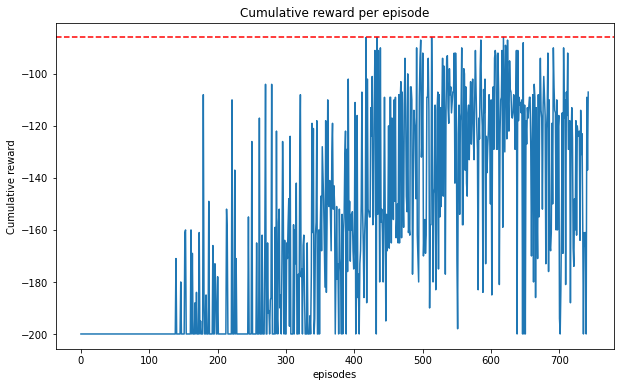

In [ ]:
plot_cumulative_reward_per_episode(reward_list)

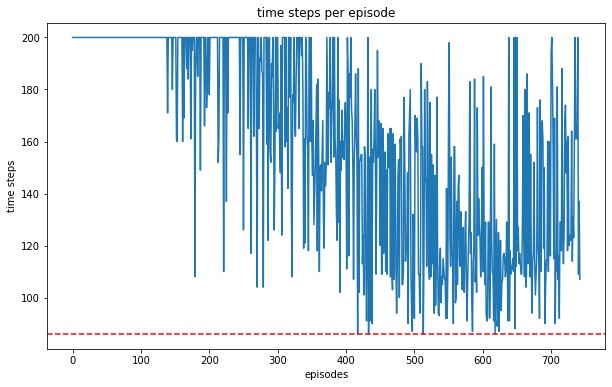

In [ ]:
plot_timestep_per_episode(time_steps_list)

### Testing

Text(0, 0.5, 'Mean cumulative reward')

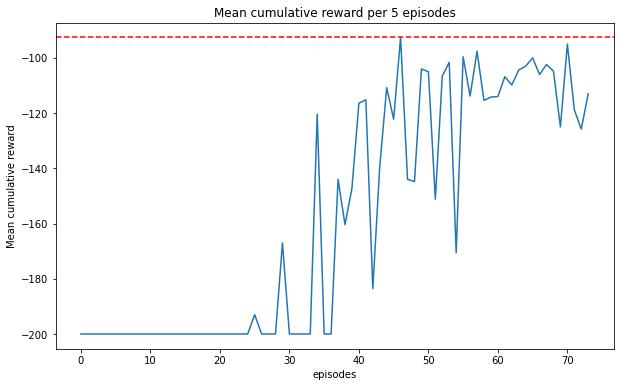

In [ ]:
#mean cumulative reward per 5 episodes
plot_cumulative_reward_per_episode(eval_reward_list)
plt.title('Mean cumulative reward per 5 episodes')
plt.xlabel('episodes')
plt.ylabel('Mean cumulative reward')

Text(0, 0.5, 'Mean timesteps')

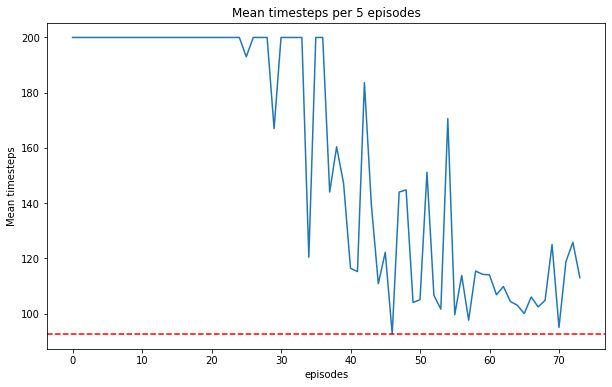

In [ ]:
#mean timesteps reward per 5 episodes
plot_timestep_per_episode(eval_time_steps_list)
plt.title('Mean timesteps per 5 episodes')
plt.xlabel('episodes')
plt.ylabel('Mean timesteps')

## Hyper parameters tunning

In [ ]:
np.argmax(reward_list)

417

In [ ]:
np.sum(time_steps_list[:417])

77601

the previous trial tool 417 to reach the optimal solution with 77601 time step so we will train for 500 episodes only fro the upcomming trials.

Trying different values of gamma and epsilon

In [ ]:
kwargs = {
    'env': env,
    'policy': 'MlpPolicy',
    'learning_rate': 4e-3,
    'batch_size': 128,
    'buffer_size': 10000,
    'learning_starts': 1000,
    'target_update_interval': 600,
    'train_freq': 16,
    'gradient_steps': 8,
    'exploration_final_eps': 0.07,
    'policy_kwargs': dict(net_arch=[256, 256]),
    'verbose': 0
  }
gamma  = [0.99 , 0.97]
exploration_fraction =  [0.3,0.1]

results_df = pd.DataFrame()

for g in gamma:
  for e in exploration_fraction:
    print(f'trining gamma {g} and exploration_rate {e}')
    dqn_model = DQN(**kwargs, gamma = g, exploration_fraction = e)
    temp_reward_list = []
    temp_time_steps_list = []
    temp_eval_reward_list = []
    temp_eval_time_steps_list = []
    callback = DoneCallback(reward_list = temp_reward_list,
                    time_steps_list = temp_time_steps_list, 
                    eval_env = eval_env,
                    eval_reward_list = temp_eval_reward_list,
                    eval_time_steps_list = temp_eval_time_steps_list,
                    max_number_of_episodes = 800,
                    save_path = None,
                    verbose = 0)
    
    dqn_model.learn(total_timesteps = n_timesteps, log_interval=100000000, callback=callback)

    temp_df = pd.DataFrame()
    temp_df['reward_list'] = temp_reward_list
    temp_df['gamma'] = g
    temp_df['exploration_rate'] = e
    results_df = pd.concat([results_df,temp_df])
    

trining gamma 0.99 and exploration_rate 0.3


/usr/local/lib/python3.7/dist-packages/stable_baselines3/common/evaluation.py:69: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  UserWarning,


trining gamma 0.99 and exploration_rate 0.1
trining gamma 0.97 and exploration_rate 0.3
trining gamma 0.97 and exploration_rate 0.1


the upcomming 3 cells from : https://towardsdatascience.com/hands-on-reinforcement-learning-course-part-2-1b0828a1046b

In [ ]:
results_df = results_df.reset_index().rename(columns = {'index':'episode'})

In [ ]:
results_df['hyperparam'] = [f'gamma = {g}, exploration_rate = {e}' for (g,e) in zip(results_df['gamma'],results_df['exploration_rate'])]

In [ ]:
results_df

,episode,reward_list,gamma,exploration_rate,hyperparam
0,0,-200.0,0.99,0.3,"gamma = 0.99, exploration_rate = 0.3"
1,1,-200.0,0.99,0.3,"gamma = 0.99, exploration_rate = 0.3"
2,2,-200.0,0.99,0.3,"gamma = 0.99, exploration_rate = 0.3"
3,3,-200.0,0.99,0.3,"gamma = 0.99, exploration_rate = 0.3"
4,4,-200.0,0.99,0.3,"gamma = 0.99, exploration_rate = 0.3"
...,...,...,...,...,...
2822,716,-168.0,0.97,0.1,"gamma = 0.97, exploration_rate = 0.1"
2823,717,-151.0,0.97,0.1,"gamma = 0.97, exploration_rate = 0.1"
2824,718,-172.0,0.97,0.1,"gamma = 0.97, exploration_rate = 0.1"
2825,719,-92.0,0.97,0.1,"gamma = 0.97, exploration_rate = 0.1"


/usr/local/lib/python3.7/dist-packages/seaborn/_decorators.py:43: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning


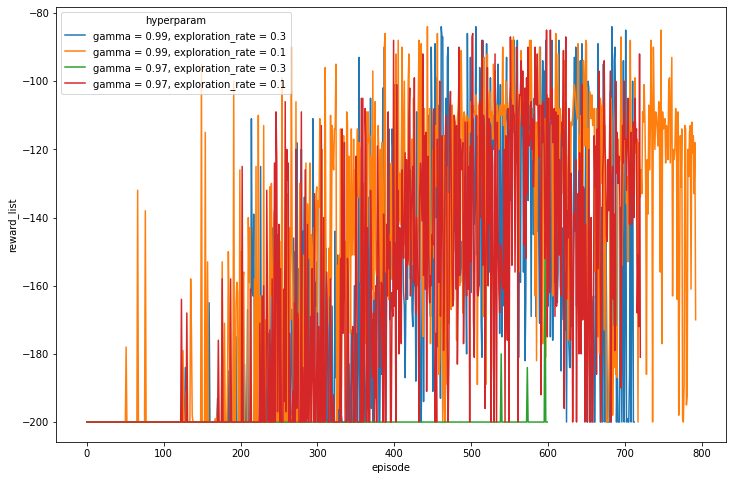

In [ ]:
import seaborn as sns
fig = plt.gcf()
fig.set_size_inches(12,8)
sns.lineplot('episode','reward_list',hue = 'hyperparam', data = results_df)

make the plot easier to read

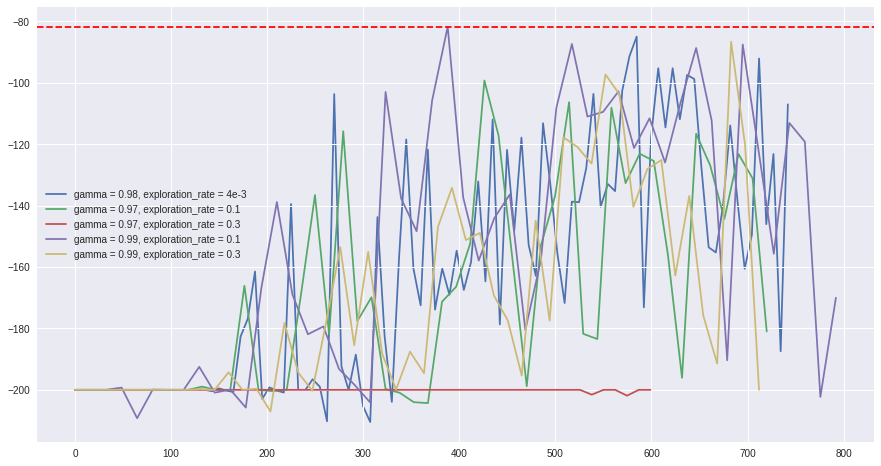

In [ ]:
from scipy.interpolate import make_interp_spline
plt.figure(figsize = (15,8))
plt.style.use('seaborn')
max_value = max(reward_list)
best_params = 'gamma = 0.98, exploration_rate = 4e-3'


B_spline_coeff = make_interp_spline(np.arange(len(reward_list)), reward_list)
X_Final = np.linspace(0 , len(reward_list) - 1, 100)
Y_Final = B_spline_coeff(X_Final)
plt.plot(X_Final,Y_Final,label = 'gamma = 0.98, exploration_rate = 4e-3',zorder = 0)
max_value = max(Y_Final)

for hyperparam, df in results_df.groupby('hyperparam'):
    B_spline_coeff = make_interp_spline(df['episode'], df['reward_list'])
    X_Final = np.linspace(df['episode'].min(), df['episode'].max(), 50)
    Y_Final = B_spline_coeff(X_Final)
    plt.plot(X_Final,Y_Final,label = hyperparam)
    if max(Y_Final) > max_value:
      max_value = max(Y_Final)
      best_params = hyperparam


plt.legend()

plt.axhline(y = max_value, color='r', linestyle='--')





In [ ]:
best_params

'gamma = 0.99, exploration_rate = 0.1'

it looks like gamma = 0.99, exploration_rate = 0.1 may achieve better performance but the current performance is sufficient

> # Q-Learning

In [ ]:
try:
    from google.colab import drive
    %tensorflow_version 2.x
    COLAB = True
    print("Note: using Google CoLab")
except:
    print("Note: not using Google CoLab")
    COLAB = False

Note: using Google CoLab


> ### Install some Packages

In [ ]:
%%capture
!pip install gym==0.22
!pip install tf-agents[reverb]
# HIDE OUTPUT
if COLAB:
  !sudo apt-get install -y xvfb ffmpeg x11-utils
  !pip install -q 'imageio==2.4.0'
  !pip install -q PILLOW
  !pip install -q 'pyglet==1.3.2'
  !pip install -q pyvirtualdisplay
  !pip install -q pygame

> ### Import some libraries

In [ ]:
import tf_agents
from tf_agents.environments import suite_gym
import PIL.Image
import pyvirtualdisplay

import gym
import numpy as np
import pandas as pd

from gym.wrappers import Monitor
import glob
import io
import base64
from IPython.display import HTML
from pyvirtualdisplay import Display
from IPython import display as ipythondisplay

import matplotlib.pyplot as plt

In [ ]:
display = Display(visible=0, size=(1400, 900))
display.start()

#this methods for help us to visualize the car. The following code shows a video of the car when run from a notebook.
def show_video():
    mp4list = glob.glob('video/*.mp4')
    if len(mp4list) > 0:
        mp4 = mp4list[0]
        video = io.open(mp4, 'r+b').read()
        encoded = base64.b64encode(video)
        ipythondisplay.display(HTML(data='''<video alt="test" autoplay 
                loop controls style="height: 400px;">
                <source src="data:video/mp4;base64,{0}" 
                type="video/mp4" />
             </video>'''.format(encoded.decode('ascii'))))
    else:
        print("Could not find video")


def wrap_env(env):
    env = Monitor(env, './video', force=True)
    return env


> We are now ready to train the agent.

In [ ]:
#check if I use colab or on local environment
if COLAB:
    env = wrap_env(gym.make("MountainCar-v0"))
else:
    env = gym.make("MountainCar-v0")

env.reset()
done = False

i = 0
while not done:
    i += 1
    state, reward, done, _ = env.step(2)
    env.render()
    print(f"Step {i}: State={state}, Reward={reward}")

env.close()


Step 1: State=[-0.5673797   0.00133736], Reward=-1.0
Step 2: State=[-0.56471497  0.00266477], Reward=-1.0
Step 3: State=[-0.5607426   0.00397236], Reward=-1.0
Step 4: State=[-0.5554922   0.00525036], Reward=-1.0
Step 5: State=[-0.54900306  0.0064892 ], Reward=-1.0
Step 6: State=[-0.5413235   0.00767954], Reward=-1.0
Step 7: State=[-0.53251106  0.00881242], Reward=-1.0
Step 8: State=[-0.5226318   0.00987925], Reward=-1.0
Step 9: State=[-0.5117598  0.010872 ], Reward=-1.0
Step 10: State=[-0.4999766   0.01178323], Reward=-1.0
Step 11: State=[-0.4873704   0.01260621], Reward=-1.0
Step 12: State=[-0.47403535  0.01333503], Reward=-1.0
Step 13: State=[-0.4600707   0.01396467], Reward=-1.0
Step 14: State=[-0.4455796   0.01449109], Reward=-1.0
Step 15: State=[-0.43066832  0.01491128], Reward=-1.0
Step 16: State=[-0.41544503  0.01522329], Reward=-1.0
Step 17: State=[-0.40001872  0.01542629], Reward=-1.0
Step 18: State=[-0.3844982   0.01552053], Reward=-1.0
Step 19: State=[-0.3689909   0.01550729

> It helps to visualize the car. The following code shows a video of the car when run from a notebook.

In [ ]:
# HIDE OUTPUT
show_video()

> ### Reinforcement Learning

> Q-Learning is a system of rewards that the algorithm gives an agent for successfully moving the environment into a state considered successful. These rewards are the Q-values from which this algorithm takes its name. The final output from the Q-Learning algorithm is a table of Q-values that indicate the reward value of every action that the agent can take, given every possible environment state. The agent must bin continuous state values into a fixed finite number of columns.

> Learning occurs when the algorithm runs the agent and environment through episodes and updates the Q-values based on the rewards received from actions taken; Figure 1.REINF provides a high-level overview of this reinforcement or Q-Learning loop.

> ![Reinforcement Learning](https://raw.githubusercontent.com/jeffheaton/t81_558_deep_learning/master/images/reinforcement.png "Reinforcement Learning")

> **Figure 1.REINF:Reinforcement/Q Learning**

> The Q-values can dictate action by selecting the action column with the highest Q-value for the current environment state. The choice between choosing a random action and a Q-value-driven action is governed by the epsilon ($\epsilon$) parameter, the probability of random action.

> Each time through the training loop, the training algorithm updates the Q-values according to the following equation.


> $Q^{new}(s_{t},a_{t}) \leftarrow \underbrace{Q(s_{t},a_{t})}_{\text{old value}} + \underbrace{\alpha}_{\text{learning rate}} \cdot  \overbrace{\bigg( \underbrace{\underbrace{r_{t}}_{\text{reward}} + \underbrace{\gamma}_{\text{discount factor}} \cdot \underbrace{\max_{a}Q(s_{t+1}, a)}_{\text{estimate of optimal future value}}}_{\text{new value (temporal difference target)}} - \underbrace{Q(s_{t},a_{t})}_{\text{old value}} \bigg) }^{\text{temporal difference}}$

> There are several parameters in this equation:
* alpha ($\alpha$) - The learning rate, how much should the current step cause the Q-values to be updated.
* lambda ($\lambda$) - The discount factor is the percentage of future reward that the algorithm should consider in this update.

> This equation modifies several values:

>* $Q(s_t,a_t)$ - The Q-table.  For each combination of states, what reward would the agent likely receive for performing each action?
* $s_t$ - The current state.
* $r_t$ - The last reward received.
* $a_t$ - The action that the agent will perform.

> The equation works by calculating a delta (temporal difference) that the equation should apply to the old state. This learning rate ($\alpha$) scales this delta. A learning rate of 1.0 would fully implement the temporal difference in the Q-values each iteration and would likely be very chaotic.

> There are two parts to the temporal difference: the new and old values. The new value is subtracted from the old value to provide a delta; the full amount we would change the Q-value by if the learning rate did not scale this value. The new value is a summation of the reward received from the last action and the maximum Q-values from the resulting state when the client takes this action. Adding the maximum of action Q-values for the new state is essential because it estimates the optimal future values from proceeding with this action. 

> ### Q-Learning Car

> We will now use Q-Learning to produce a car that learns to drive itself. 

> We begin by defining two essential functions.


In [ ]:
# This function converts the floating point state values into
# discrete values. This is often called binning.  We divide
# the range that the state values might occupy and assign
# each region to a bucket.
def discrete_state_convert(state):
    discrete_state = (state - env.observation_space.low)/buckets
    return tuple(discrete_state.astype(int))

# Run one game.  The q_table to use is provided.  We also
# provide a flag to indicate if the game should be
# rendered/animated.  Finally, we also provide
# a flag to indicate if the q_table should be updated.
global_total_reward = []
total_time_step = []
def run_game(q_table, render, should_update):
    done = False
    discrete_state = discrete_state_convert(env.reset())
    success = False
    total_reward = 0.0

    while not done:
        # Check if we will exploit or explore
        if np.random.random() > epsilon:
            # Exploit : using the q-table to take current the best action
            action = np.argmax(q_table[discrete_state])
        else:
            # Explore - t
            action = np.random.randint(0, env.action_space.n)

        # Run simulation step, and store the total reward
        new_state, reward, done, _ = env.step(action)
        total_reward += reward
         
        # Convert continuous environment states to discrete environment state
        new_state_disc = discrete_state_convert(new_state)

        # Are we reached the goal state ?
        if new_state[0] >= env.unwrapped.goal_position:
            success = True

        # Update the q-table by using q learning algorithm formula
        if should_update:
            max_future_q = np.max(q_table[new_state_disc])
            current_q = q_table[discrete_state + (action,)]
            new_q = current_q + LEARNING_RATE * (reward + DISCOUNT * max_future_q - current_q)
            q_table[discrete_state + (action,)] = new_q

        discrete_state = new_state_disc

        if render:
            env.render()

    #display the total reward and the total time step for each episode and store the results into the list total_time_step, global_total_reward
    global_total_reward.append(total_reward)
    if total_reward != -200 :
      var_ = (-1 *total_reward ) + 1
      total_time_step.append(var_)
      print('total_reward : ', total_reward, ',  Total_Time_step_per_episod : ', var_ )
    else:
      var_2 = (-1 * (total_reward))
      total_time_step.append(var_2)
      print('total_reward : ', total_reward, ',  Total_Time_step_per_episod : ', var_2)

    return success

In [ ]:
#This method for run the model after training by using the optimal q-table values (Exploit all times) and return with the optimal total reward
def play(q_table, env):
  # Convert continuous environment states to discrete environment state
  discrete_state = discrete_state_convert(env.reset())
  done = False
  total_reward = 0.0
  while not done:
    # Exploit : using the q-table to take current the best action
    action = np.argmax(q_table[discrete_state])
    # Run simulation step
    new_state, reward, done, _ = env.step(action)
    total_reward += reward
    discrete_state = discrete_state_convert(new_state)
    env.render()
  env.close()
  return total_reward

In [ ]:
#This method to test the training model on the 5 episodes
def test(q_table, env):
  reward_list = []
  #run for 5 episodes
  for _ in range(5):
    # Convert continuous environment states to discrete environment state
    discrete_state = discrete_state_convert(env.reset())
    done = False
    total_reward = 0.0
    while not done:
      # Exploit : using the q-table to take current the best action
      action = np.argmax(q_table[discrete_state])
      new_state, reward, done, _ = env.step(action)
      # Run simulation step
      total_reward += reward
      discrete_state = discrete_state_convert(new_state)
  
    reward_list.append(total_reward)

  
  return reward_list

> Several hyperparameters are very important for Q-Learning. These parameters will likely need adjustment as you apply Q-Learning to other problems. Because of this, it is crucial to understand the role of each parameter.

> * **LEARNING_RATE** The rate at which previous Q-values are updated based on new episodes run during training. 
* **DISCOUNT** The amount of significance to give estimates of future rewards when added to the reward for the current action taken. A value of 0.99 would indicate a discount of 1% on the future reward estimates. 
* **EPISODES** The number of episodes to train over. Increase this for more complex problems; however, training time also increases.
* **SHOW_EVERY** How many episodes to allow to elapse before showing an update.
* **DISCRETE_GRID_SIZE** How many buckets to use when converting each continuous state variable. For example, [10, 10] indicates that the algorithm should use ten buckets for the first and second state variables.
* **START_EPSILON_DECAYING** Epsilon is the probability that the agent will select a random action over what the Q-Table suggests. This value determines the starting probability of randomness.
* **END_EPSILON_DECAYING** How many episodes should elapse before epsilon goes to zero and no random actions are permitted. For example, EPISODES//10  means only the first 1/10th of the episodes might have random actions.

In [ ]:
#Hyperparameters Initialization
LEARNING_RATE = 0.1
DISCOUNT = 0.99
EPISODES = 1000
SHOW_EVERY = 100

DISCRETE_GRID_SIZE = [10, 10]
START_EPSILON_DECAYING = 0.7
END_EPSILON_DECAYING = EPISODES//10


> We can now make the environment.  If we are running in Google COLAB, we wrap the environment to be displayed inside the web browser.  Next, create the discrete buckets for state and build Q-table.

In [ ]:
if COLAB:
    env = wrap_env(gym.make("MountainCar-v0"))
else:
    env = gym.make("MountainCar-v0")

epsilon = 1
epsilon_change = epsilon/(END_EPSILON_DECAYING - START_EPSILON_DECAYING)
buckets = (env.observation_space.high - env.observation_space.low) / DISCRETE_GRID_SIZE
q_table = np.random.uniform(low=-3, high=0, size=(DISCRETE_GRID_SIZE + [env.action_space.n]))
success = False

total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
The Mean Of test Reward :  -200.0
The test Reward :  [-200.0, -200.0, -200.0, -200.0, -200.0]


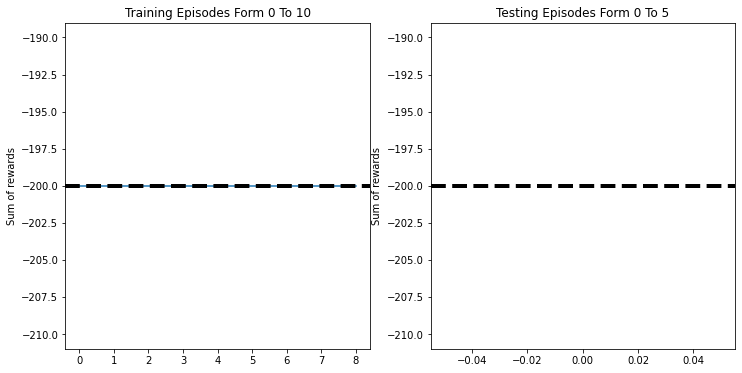

total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
The Mean Of test Reward :  -200.0
The test Reward :  [-200.0, -200.0, -200.0, -200.0, -200.0]


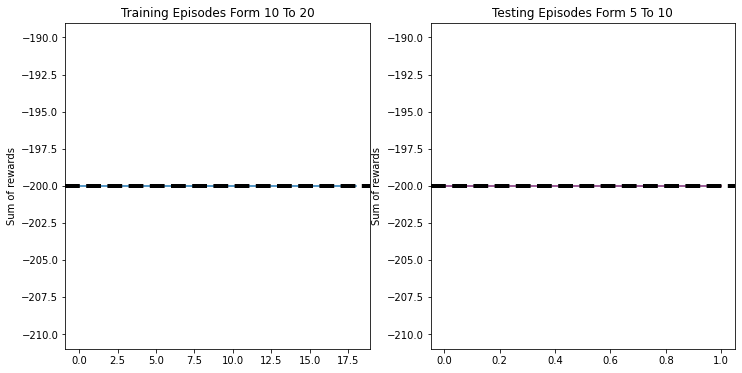

total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
The Mean Of test Reward :  -200.0
The test Reward :  [-200.0, -200.0, -200.0, -200.0, -200.0]


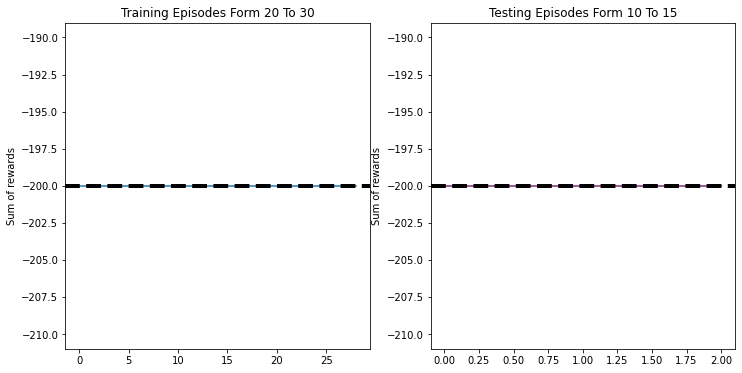

total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
The Mean Of test Reward :  -200.0
The test Reward :  [-200.0, -200.0, -200.0, -200.0, -200.0]


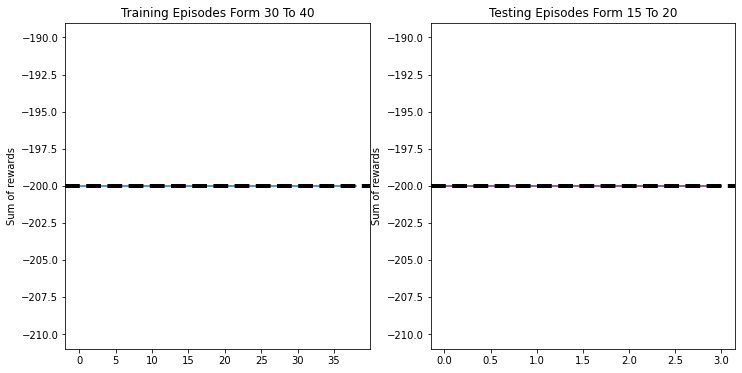

total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
The Mean Of test Reward :  -200.0
The test Reward :  [-200.0, -200.0, -200.0, -200.0, -200.0]


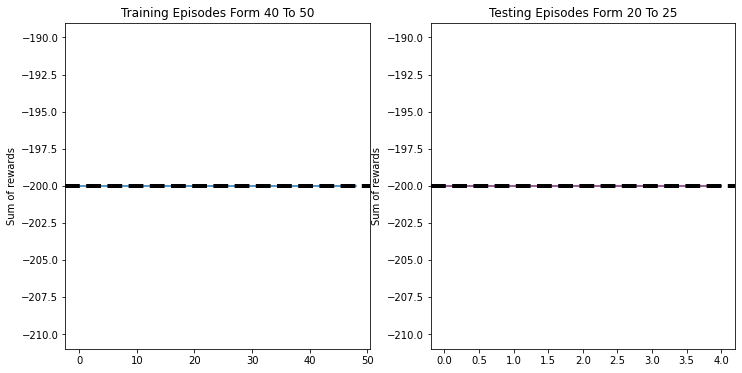

total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
The Mean Of test Reward :  -200.0
The test Reward :  [-200.0, -200.0, -200.0, -200.0, -200.0]


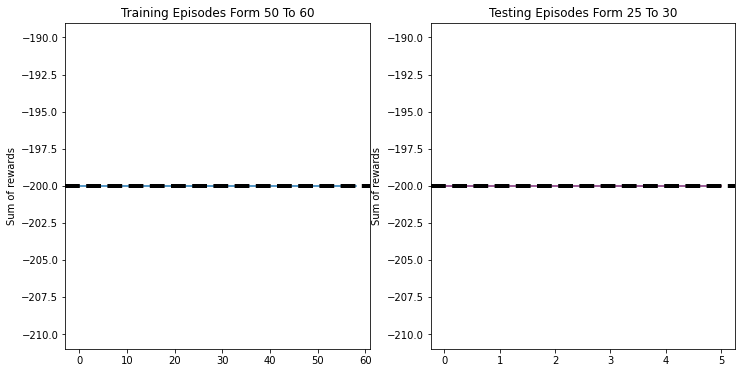

total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
The Mean Of test Reward :  -200.0
The test Reward :  [-200.0, -200.0, -200.0, -200.0, -200.0]


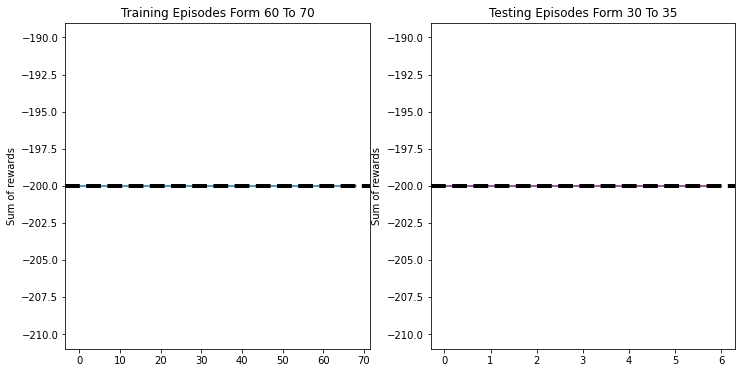

total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
The Mean Of test Reward :  -200.0
The test Reward :  [-200.0, -200.0, -200.0, -200.0, -200.0]


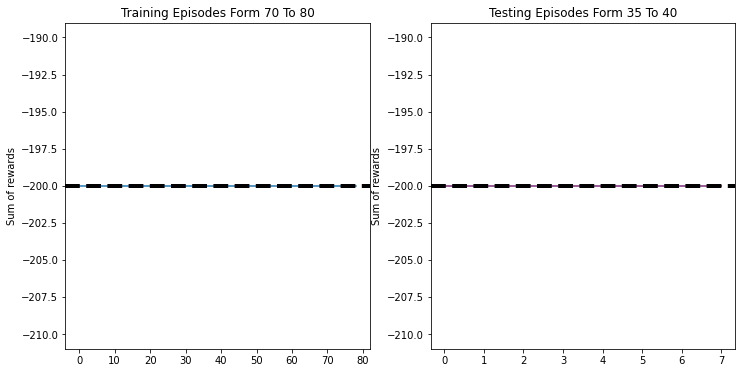

total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
The Mean Of test Reward :  -200.0
The test Reward :  [-200.0, -200.0, -200.0, -200.0, -200.0]


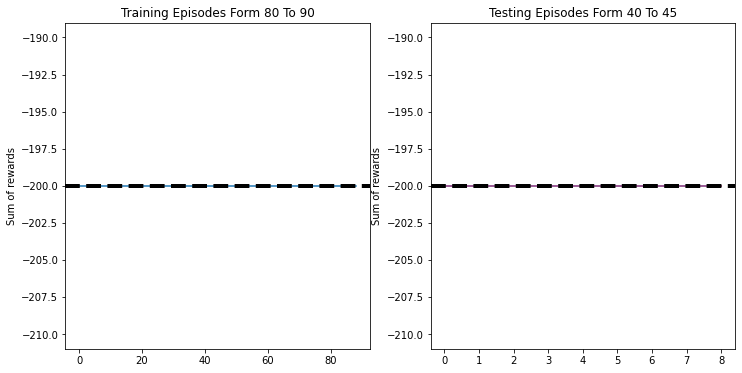

total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
The Mean Of test Reward :  -200.0
The test Reward :  [-200.0, -200.0, -200.0, -200.0, -200.0]


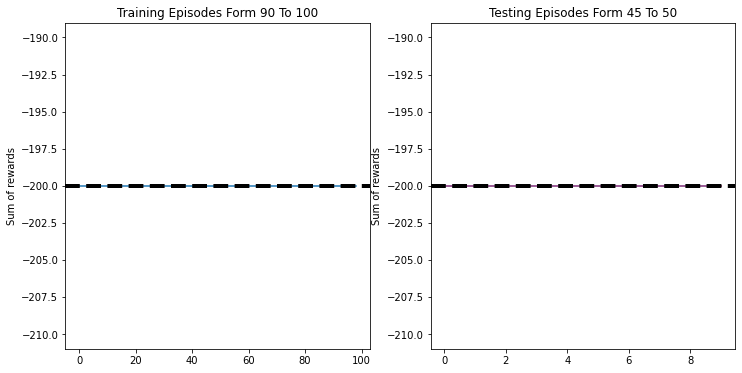

Current episode: 100, success: 0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
The Mean Of test Reward :  -193.6
The test Reward :  [-200.0, -200.0, -168.0, -200.0, -200.0]


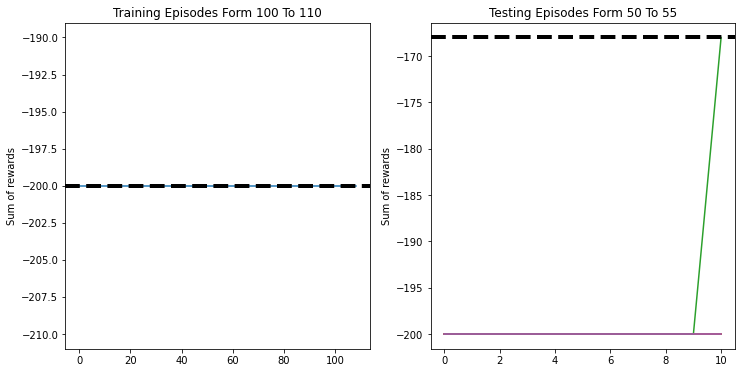

total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
The Mean Of test Reward :  -200.0
The test Reward :  [-200.0, -200.0, -200.0, -200.0, -200.0]


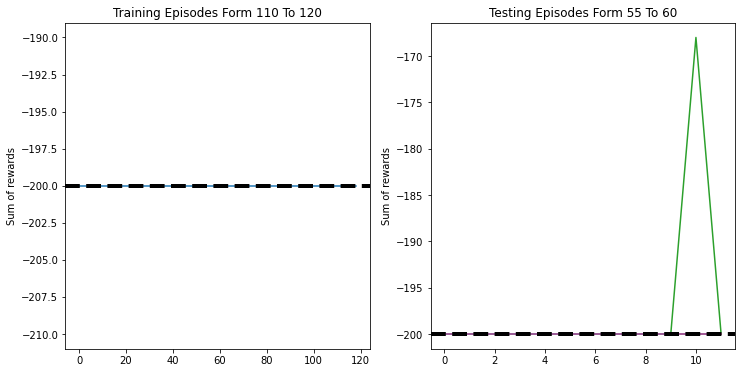

total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
The Mean Of test Reward :  -200.0
The test Reward :  [-200.0, -200.0, -200.0, -200.0, -200.0]


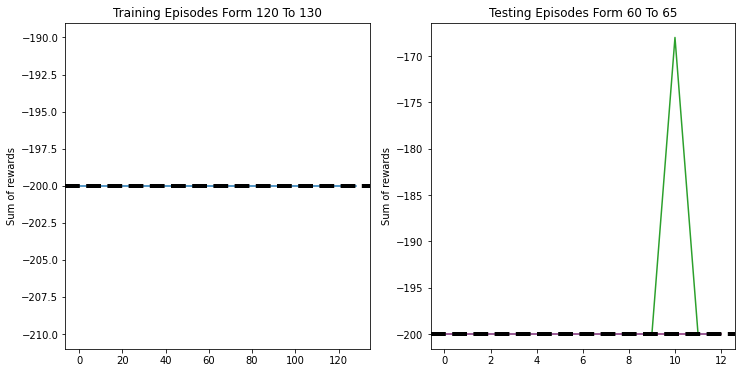

total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
The Mean Of test Reward :  -199.8
The test Reward :  [-199.0, -200.0, -200.0, -200.0, -200.0]


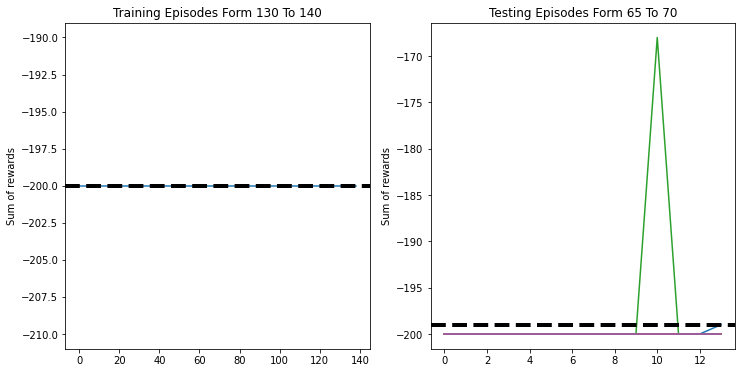

total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
The Mean Of test Reward :  -200.0
The test Reward :  [-200.0, -200.0, -200.0, -200.0, -200.0]


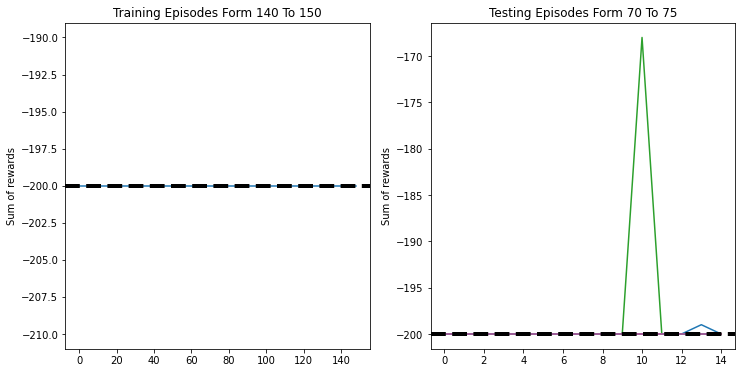

total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
The Mean Of test Reward :  -200.0
The test Reward :  [-200.0, -200.0, -200.0, -200.0, -200.0]


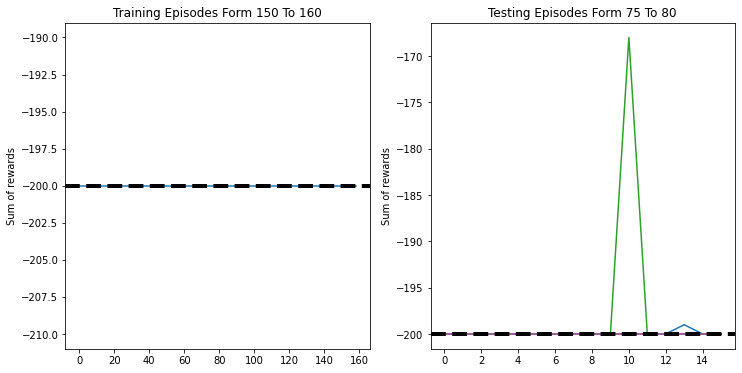

total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -163.0 ,  Total_Time_step_per_episod :  164.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
The Mean Of test Reward :  -200.0
The test Reward :  [-200.0, -200.0, -200.0, -200.0, -200.0]


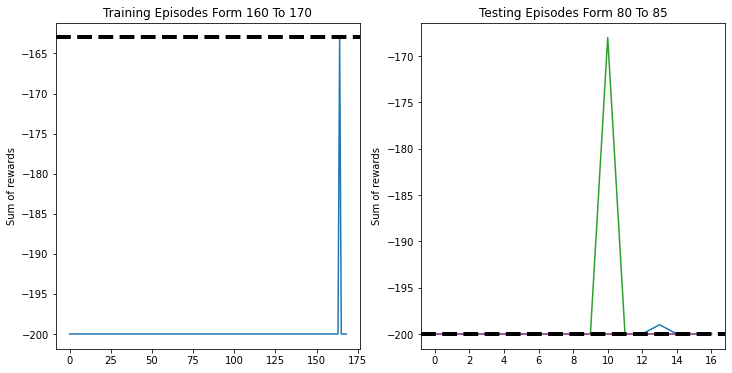

total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
The Mean Of test Reward :  -200.0
The test Reward :  [-200.0, -200.0, -200.0, -200.0, -200.0]


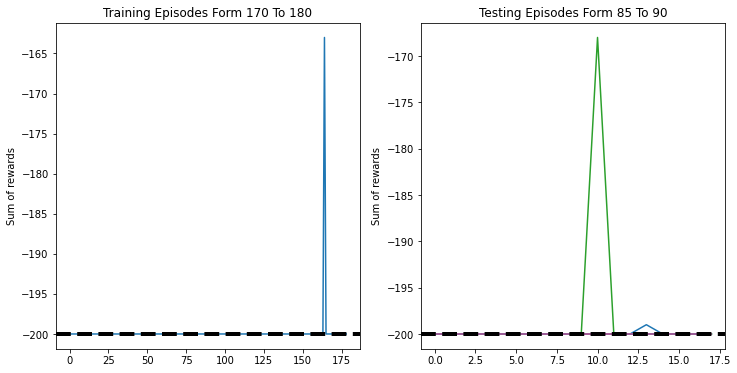

total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
The Mean Of test Reward :  -200.0
The test Reward :  [-200.0, -200.0, -200.0, -200.0, -200.0]


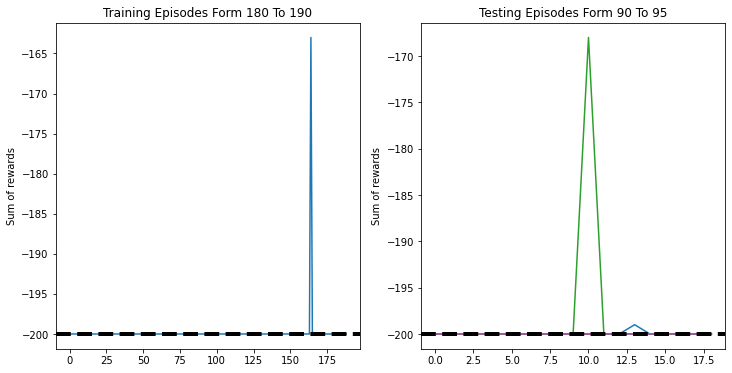

total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
The Mean Of test Reward :  -200.0
The test Reward :  [-200.0, -200.0, -200.0, -200.0, -200.0]


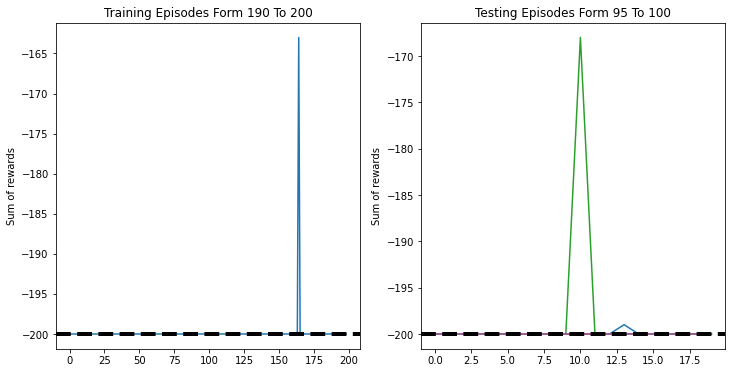

Current episode: 200, success: 1
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -174.0 ,  Total_Time_step_per_episod :  175.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
The Mean Of test Reward :  -200.0
The test Reward :  [-200.0, -200.0, -200.0, -200.0, -200.0]


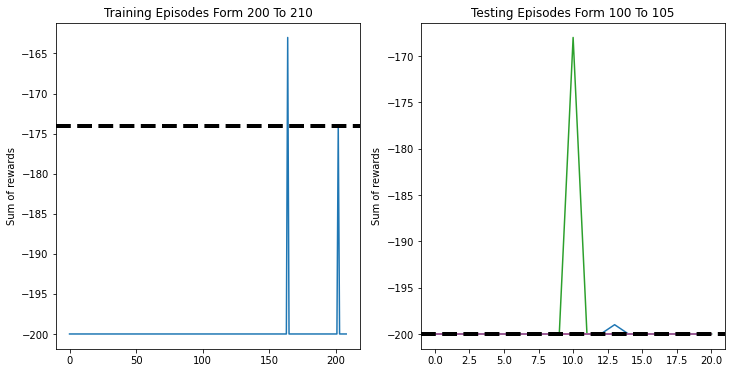

total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
The Mean Of test Reward :  -200.0
The test Reward :  [-200.0, -200.0, -200.0, -200.0, -200.0]


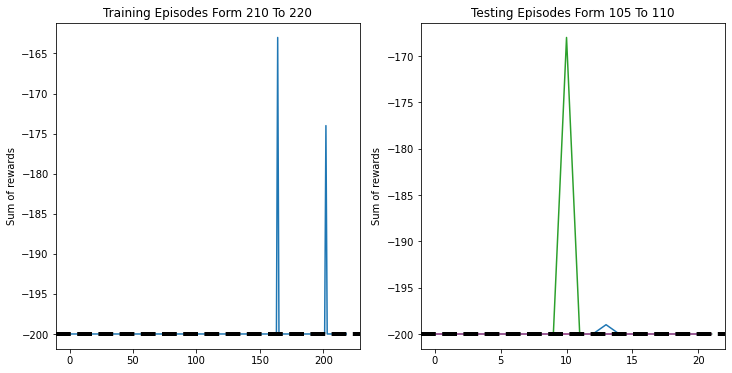

total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -197.0 ,  Total_Time_step_per_episod :  198.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
The Mean Of test Reward :  -200.0
The test Reward :  [-200.0, -200.0, -200.0, -200.0, -200.0]


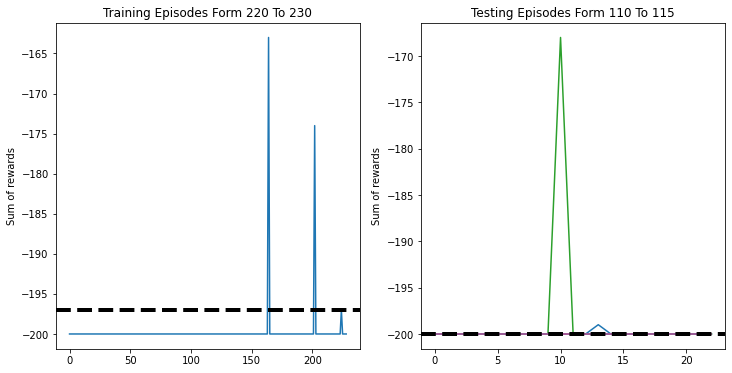

total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
The Mean Of test Reward :  -200.0
The test Reward :  [-200.0, -200.0, -200.0, -200.0, -200.0]


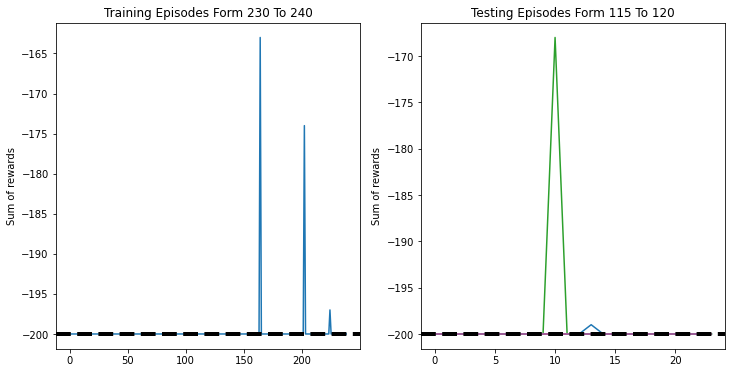

total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -192.0 ,  Total_Time_step_per_episod :  193.0
total_reward :  -167.0 ,  Total_Time_step_per_episod :  168.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
The Mean Of test Reward :  -200.0
The test Reward :  [-200.0, -200.0, -200.0, -200.0, -200.0]


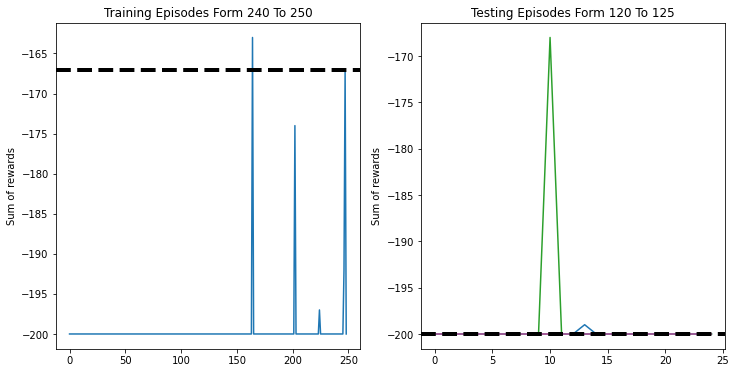

total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -163.0 ,  Total_Time_step_per_episod :  164.0
total_reward :  -192.0 ,  Total_Time_step_per_episod :  193.0
total_reward :  -160.0 ,  Total_Time_step_per_episod :  161.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -161.0 ,  Total_Time_step_per_episod :  162.0
total_reward :  -161.0 ,  Total_Time_step_per_episod :  162.0
total_reward :  -158.0 ,  Total_Time_step_per_episod :  159.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
The Mean Of test Reward :  -192.2
The test Reward :  [-200.0, -161.0, -200.0, -200.0, -200.0]


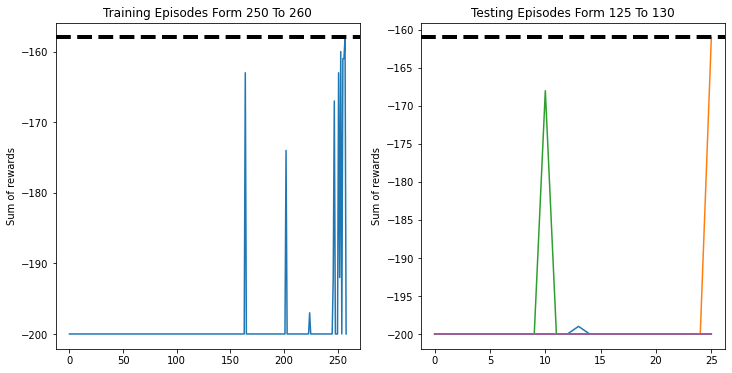

total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -189.0 ,  Total_Time_step_per_episod :  190.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -161.0 ,  Total_Time_step_per_episod :  162.0
total_reward :  -173.0 ,  Total_Time_step_per_episod :  174.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
The Mean Of test Reward :  -200.0
The test Reward :  [-200.0, -200.0, -200.0, -200.0, -200.0]


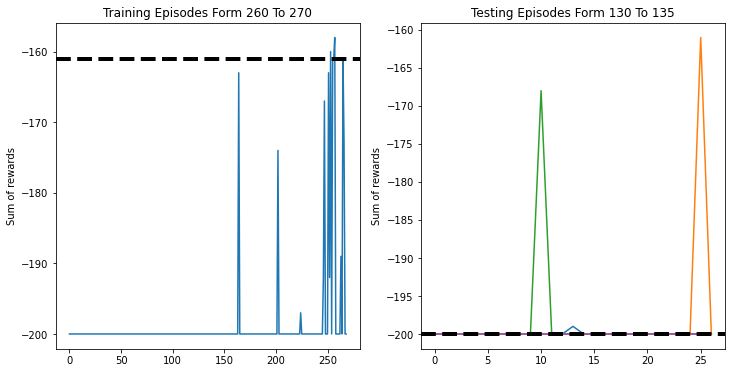

total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
The Mean Of test Reward :  -200.0
The test Reward :  [-200.0, -200.0, -200.0, -200.0, -200.0]


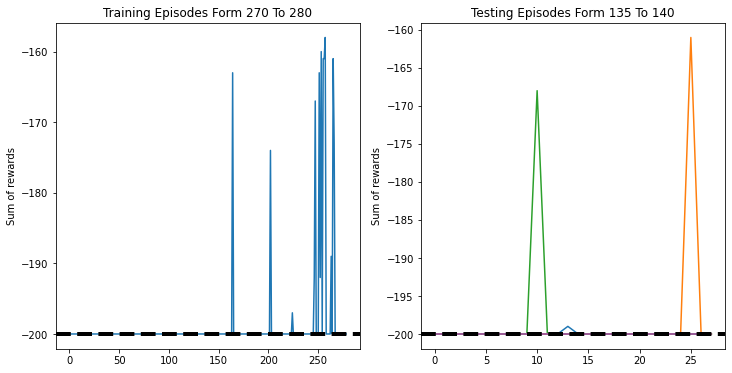

total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -183.0 ,  Total_Time_step_per_episod :  184.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
The Mean Of test Reward :  -200.0
The test Reward :  [-200.0, -200.0, -200.0, -200.0, -200.0]


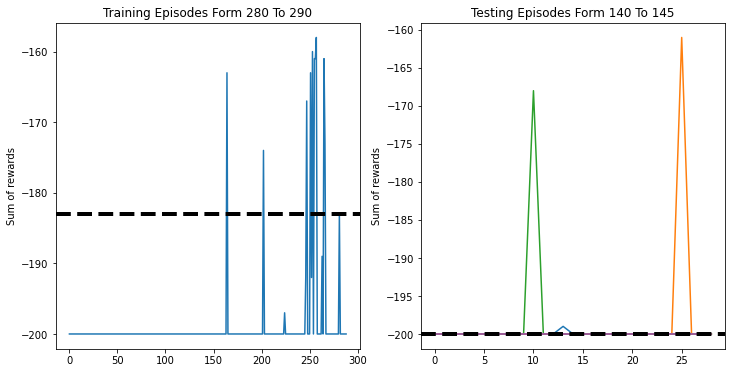

total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -183.0 ,  Total_Time_step_per_episod :  184.0
total_reward :  -182.0 ,  Total_Time_step_per_episod :  183.0
The Mean Of test Reward :  -162.8
The test Reward :  [-172.0, -147.0, -169.0, -157.0, -169.0]


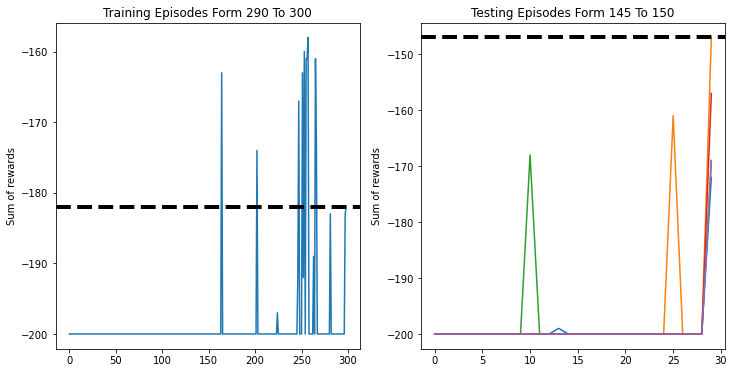

Current episode: 300, success: 16
total_reward :  -148.0 ,  Total_Time_step_per_episod :  149.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -198.0 ,  Total_Time_step_per_episod :  199.0
total_reward :  -166.0 ,  Total_Time_step_per_episod :  167.0
total_reward :  -154.0 ,  Total_Time_step_per_episod :  155.0
total_reward :  -161.0 ,  Total_Time_step_per_episod :  162.0
total_reward :  -117.0 ,  Total_Time_step_per_episod :  118.0
total_reward :  -153.0 ,  Total_Time_step_per_episod :  154.0
total_reward :  -172.0 ,  Total_Time_step_per_episod :  173.0
The Mean Of test Reward :  -200.0
The test Reward :  [-200.0, -200.0, -200.0, -200.0, -200.0]


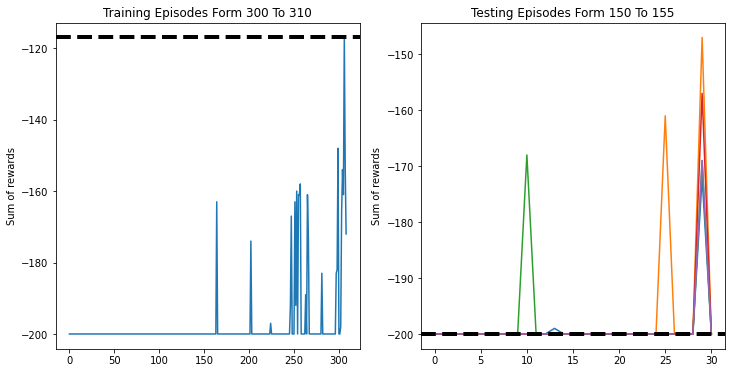

total_reward :  -164.0 ,  Total_Time_step_per_episod :  165.0
total_reward :  -154.0 ,  Total_Time_step_per_episod :  155.0
total_reward :  -160.0 ,  Total_Time_step_per_episod :  161.0
total_reward :  -177.0 ,  Total_Time_step_per_episod :  178.0
total_reward :  -165.0 ,  Total_Time_step_per_episod :  166.0
total_reward :  -176.0 ,  Total_Time_step_per_episod :  177.0
total_reward :  -178.0 ,  Total_Time_step_per_episod :  179.0
total_reward :  -148.0 ,  Total_Time_step_per_episod :  149.0
total_reward :  -150.0 ,  Total_Time_step_per_episod :  151.0
total_reward :  -152.0 ,  Total_Time_step_per_episod :  153.0
The Mean Of test Reward :  -165.0
The test Reward :  [-187.0, -179.0, -167.0, -117.0, -175.0]


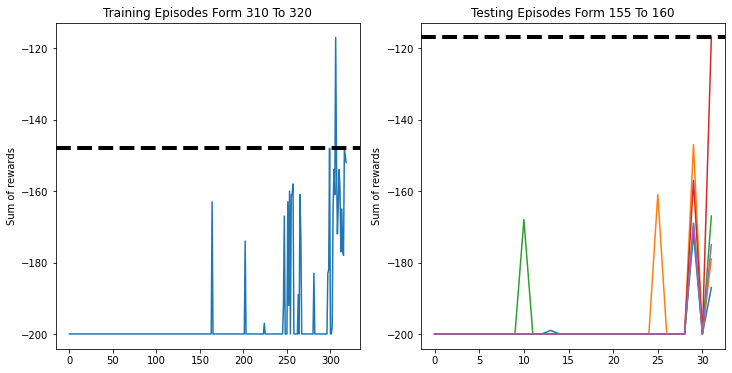

total_reward :  -174.0 ,  Total_Time_step_per_episod :  175.0
total_reward :  -199.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -160.0 ,  Total_Time_step_per_episod :  161.0
total_reward :  -156.0 ,  Total_Time_step_per_episod :  157.0
total_reward :  -172.0 ,  Total_Time_step_per_episod :  173.0
total_reward :  -147.0 ,  Total_Time_step_per_episod :  148.0
total_reward :  -148.0 ,  Total_Time_step_per_episod :  149.0
total_reward :  -165.0 ,  Total_Time_step_per_episod :  166.0
total_reward :  -146.0 ,  Total_Time_step_per_episod :  147.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
The Mean Of test Reward :  -185.4
The test Reward :  [-200.0, -192.0, -168.0, -200.0, -167.0]


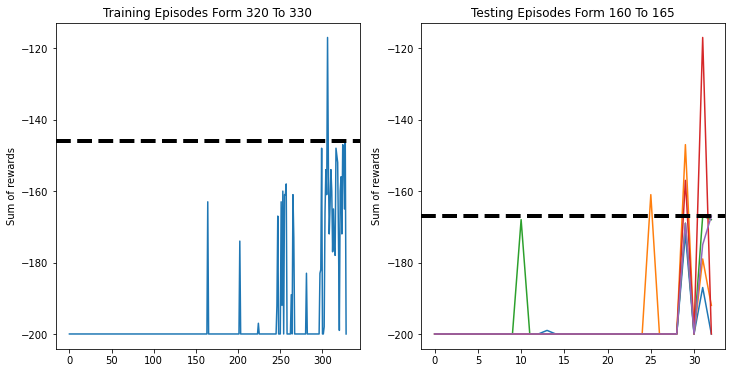

total_reward :  -164.0 ,  Total_Time_step_per_episod :  165.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -168.0 ,  Total_Time_step_per_episod :  169.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
The Mean Of test Reward :  -200.0
The test Reward :  [-200.0, -200.0, -200.0, -200.0, -200.0]


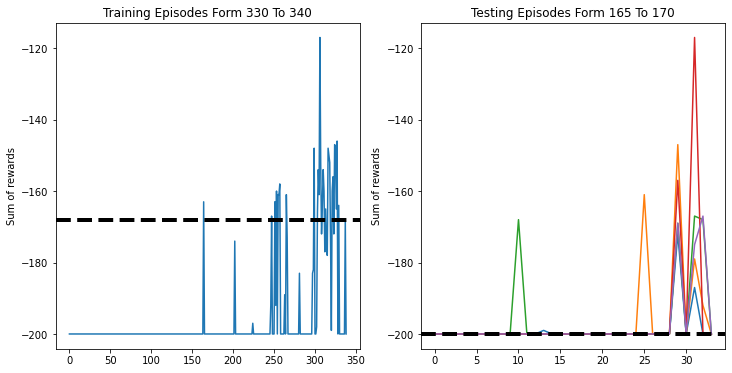

total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
The Mean Of test Reward :  -192.0
The test Reward :  [-200.0, -160.0, -200.0, -200.0, -200.0]


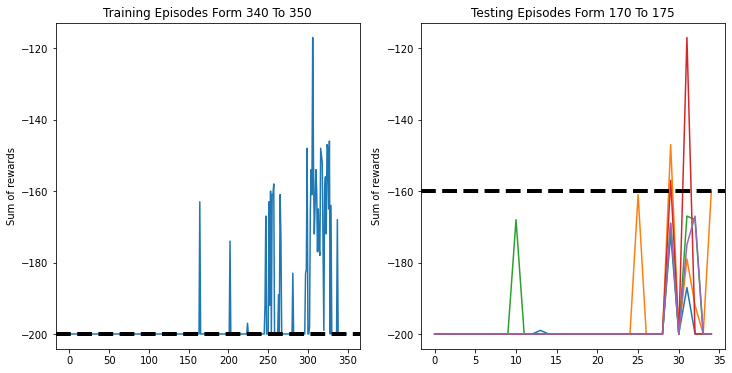

total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
The Mean Of test Reward :  -200.0
The test Reward :  [-200.0, -200.0, -200.0, -200.0, -200.0]


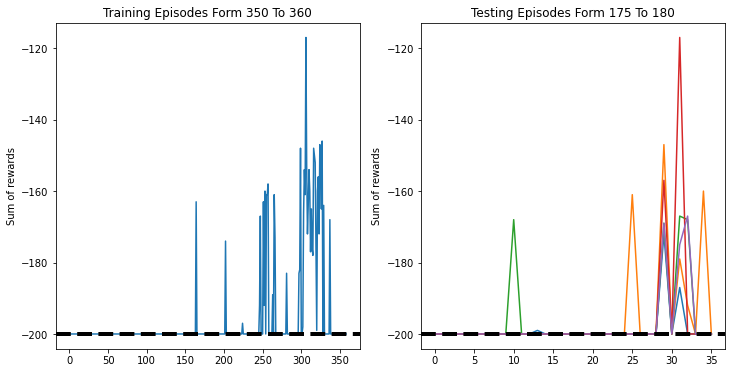

total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
The Mean Of test Reward :  -200.0
The test Reward :  [-200.0, -200.0, -200.0, -200.0, -200.0]


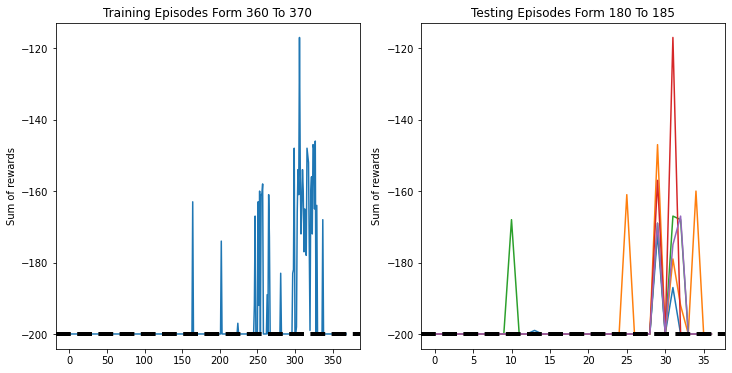

total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
The Mean Of test Reward :  -200.0
The test Reward :  [-200.0, -200.0, -200.0, -200.0, -200.0]


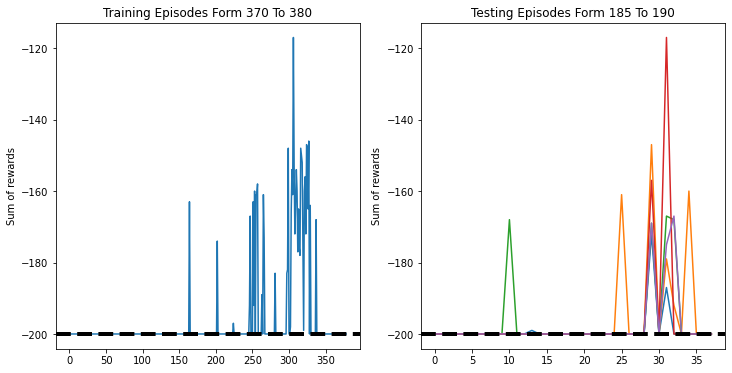

total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -152.0 ,  Total_Time_step_per_episod :  153.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -180.0 ,  Total_Time_step_per_episod :  181.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
The Mean Of test Reward :  -200.0
The test Reward :  [-200.0, -200.0, -200.0, -200.0, -200.0]


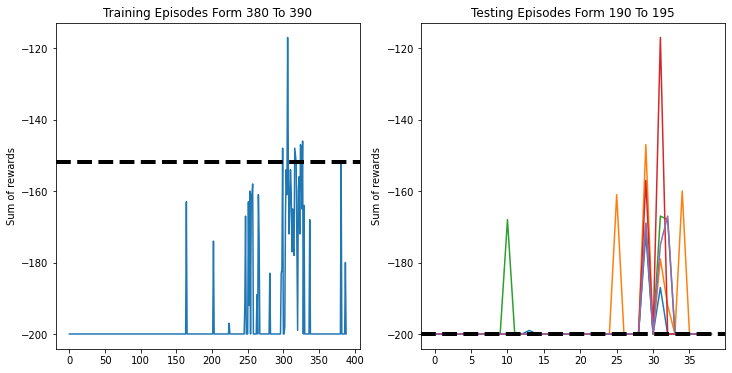

total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -158.0 ,  Total_Time_step_per_episod :  159.0
total_reward :  -178.0 ,  Total_Time_step_per_episod :  179.0
total_reward :  -165.0 ,  Total_Time_step_per_episod :  166.0
total_reward :  -152.0 ,  Total_Time_step_per_episod :  153.0
total_reward :  -157.0 ,  Total_Time_step_per_episod :  158.0
total_reward :  -151.0 ,  Total_Time_step_per_episod :  152.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -198.0 ,  Total_Time_step_per_episod :  199.0
total_reward :  -185.0 ,  Total_Time_step_per_episod :  186.0
The Mean Of test Reward :  -171.6
The test Reward :  [-174.0, -174.0, -180.0, -150.0, -180.0]


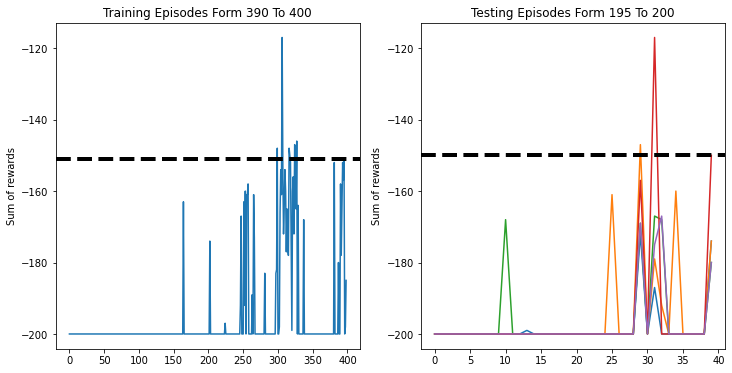

Current episode: 400, success: 39
total_reward :  -198.0 ,  Total_Time_step_per_episod :  199.0
total_reward :  -179.0 ,  Total_Time_step_per_episod :  180.0
total_reward :  -187.0 ,  Total_Time_step_per_episod :  188.0
total_reward :  -189.0 ,  Total_Time_step_per_episod :  190.0
total_reward :  -164.0 ,  Total_Time_step_per_episod :  165.0
total_reward :  -196.0 ,  Total_Time_step_per_episod :  197.0
total_reward :  -192.0 ,  Total_Time_step_per_episod :  193.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
The Mean Of test Reward :  -200.0
The test Reward :  [-200.0, -200.0, -200.0, -200.0, -200.0]


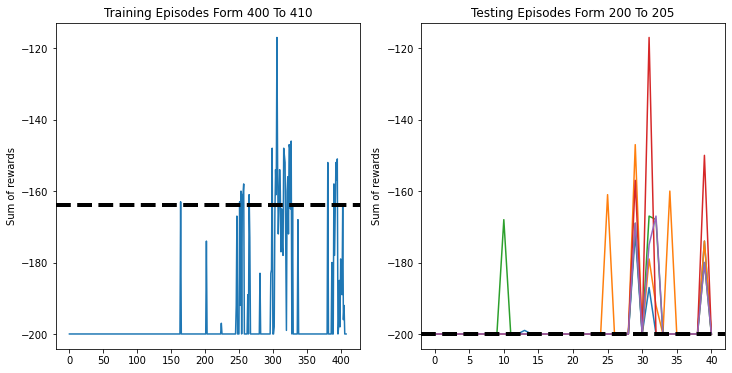

total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
The Mean Of test Reward :  -194.4
The test Reward :  [-200.0, -200.0, -200.0, -172.0, -200.0]


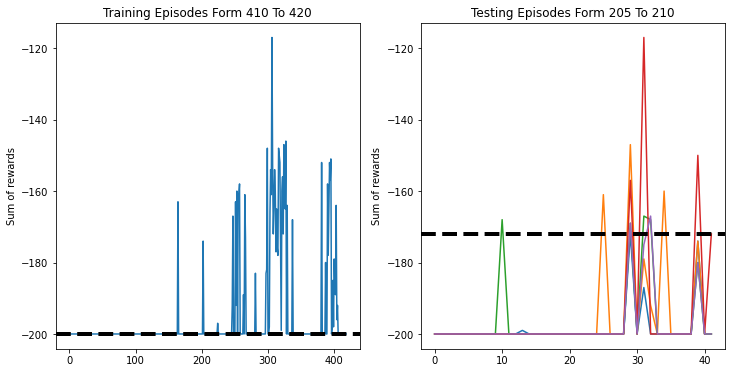

total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -161.0 ,  Total_Time_step_per_episod :  162.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -157.0 ,  Total_Time_step_per_episod :  158.0
The Mean Of test Reward :  -154.6
The test Reward :  [-158.0, -161.0, -146.0, -164.0, -144.0]


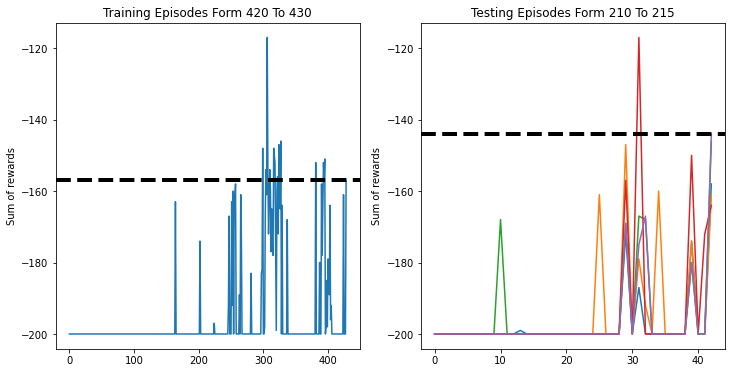

total_reward :  -152.0 ,  Total_Time_step_per_episod :  153.0
total_reward :  -155.0 ,  Total_Time_step_per_episod :  156.0
total_reward :  -159.0 ,  Total_Time_step_per_episod :  160.0
total_reward :  -167.0 ,  Total_Time_step_per_episod :  168.0
total_reward :  -175.0 ,  Total_Time_step_per_episod :  176.0
total_reward :  -199.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -146.0 ,  Total_Time_step_per_episod :  147.0
total_reward :  -165.0 ,  Total_Time_step_per_episod :  166.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
The Mean Of test Reward :  -160.2
The test Reward :  [-164.0, -166.0, -162.0, -161.0, -148.0]


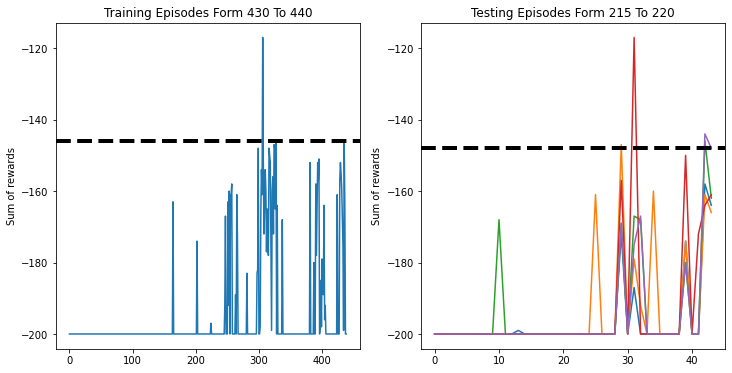

total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -169.0 ,  Total_Time_step_per_episod :  170.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
The Mean Of test Reward :  -179.0
The test Reward :  [-160.0, -200.0, -179.0, -156.0, -200.0]


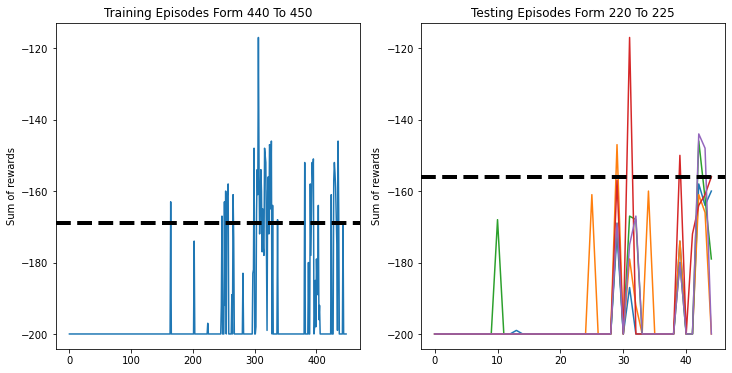

total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -146.0 ,  Total_Time_step_per_episod :  147.0
total_reward :  -197.0 ,  Total_Time_step_per_episod :  198.0
total_reward :  -158.0 ,  Total_Time_step_per_episod :  159.0
total_reward :  -175.0 ,  Total_Time_step_per_episod :  176.0
total_reward :  -148.0 ,  Total_Time_step_per_episod :  149.0
total_reward :  -148.0 ,  Total_Time_step_per_episod :  149.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
The Mean Of test Reward :  -154.6
The test Reward :  [-169.0, -157.0, -151.0, -148.0, -148.0]


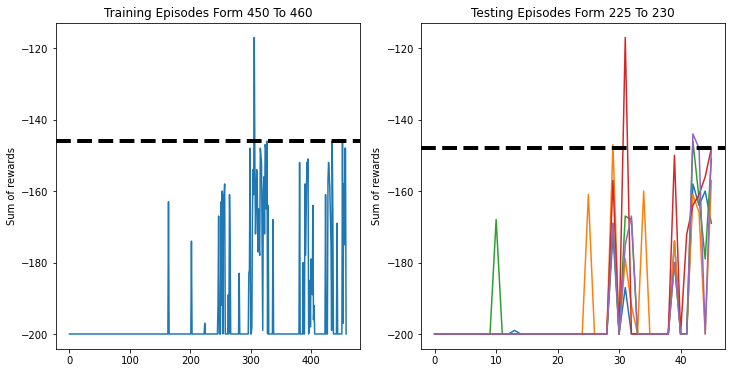

total_reward :  -151.0 ,  Total_Time_step_per_episod :  152.0
total_reward :  -175.0 ,  Total_Time_step_per_episod :  176.0
total_reward :  -157.0 ,  Total_Time_step_per_episod :  158.0
total_reward :  -151.0 ,  Total_Time_step_per_episod :  152.0
total_reward :  -160.0 ,  Total_Time_step_per_episod :  161.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
The Mean Of test Reward :  -200.0
The test Reward :  [-200.0, -200.0, -200.0, -200.0, -200.0]


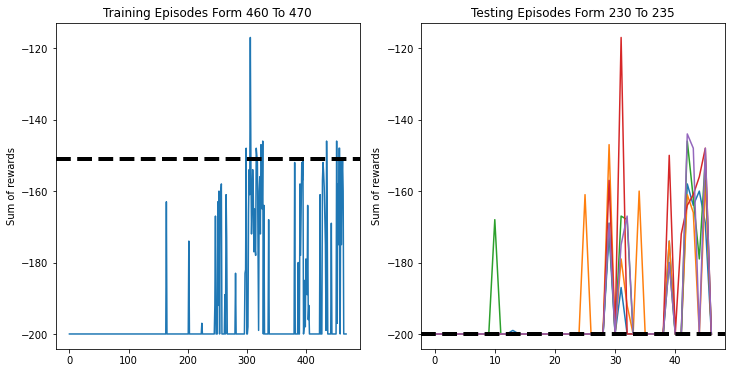

total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
The Mean Of test Reward :  -200.0
The test Reward :  [-200.0, -200.0, -200.0, -200.0, -200.0]


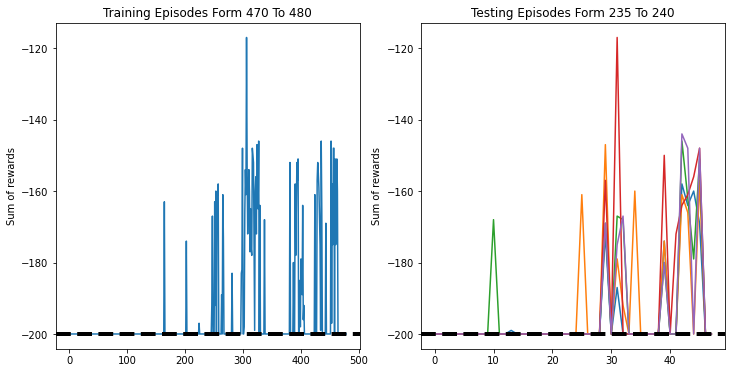

total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
The Mean Of test Reward :  -189.6
The test Reward :  [-200.0, -200.0, -148.0, -200.0, -200.0]


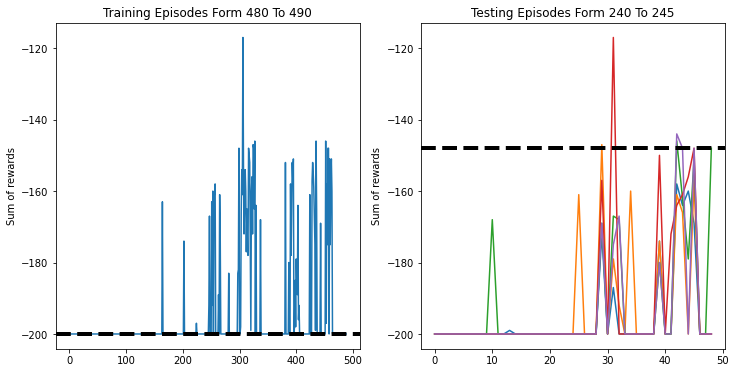

total_reward :  -150.0 ,  Total_Time_step_per_episod :  151.0
total_reward :  -154.0 ,  Total_Time_step_per_episod :  155.0
total_reward :  -151.0 ,  Total_Time_step_per_episod :  152.0
total_reward :  -190.0 ,  Total_Time_step_per_episod :  191.0
total_reward :  -172.0 ,  Total_Time_step_per_episod :  173.0
total_reward :  -179.0 ,  Total_Time_step_per_episod :  180.0
total_reward :  -156.0 ,  Total_Time_step_per_episod :  157.0
total_reward :  -166.0 ,  Total_Time_step_per_episod :  167.0
total_reward :  -174.0 ,  Total_Time_step_per_episod :  175.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
The Mean Of test Reward :  -163.2
The test Reward :  [-160.0, -159.0, -177.0, -159.0, -161.0]


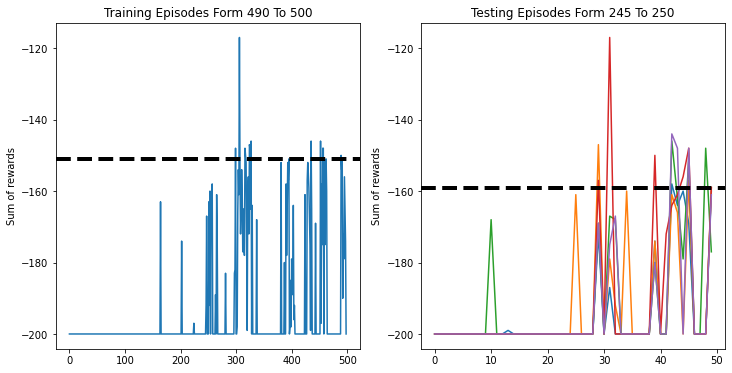

Current episode: 500, success: 38
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -158.0 ,  Total_Time_step_per_episod :  159.0
total_reward :  -167.0 ,  Total_Time_step_per_episod :  168.0
total_reward :  -156.0 ,  Total_Time_step_per_episod :  157.0
total_reward :  -157.0 ,  Total_Time_step_per_episod :  158.0
total_reward :  -158.0 ,  Total_Time_step_per_episod :  159.0
total_reward :  -179.0 ,  Total_Time_step_per_episod :  180.0
total_reward :  -153.0 ,  Total_Time_step_per_episod :  154.0
total_reward :  -166.0 ,  Total_Time_step_per_episod :  167.0
total_reward :  -168.0 ,  Total_Time_step_per_episod :  169.0
The Mean Of test Reward :  -172.6
The test Reward :  [-179.0, -163.0, -179.0, -179.0, -163.0]


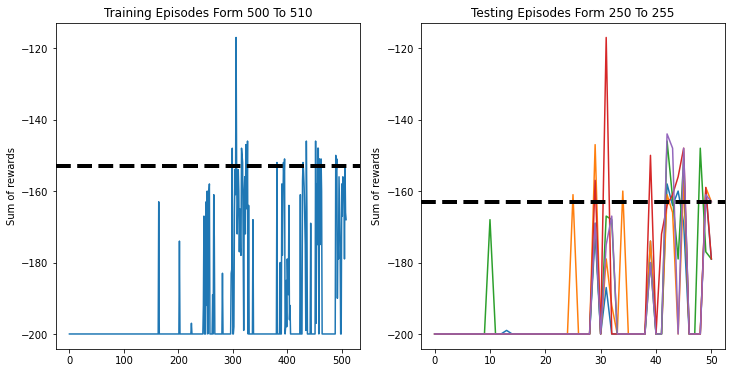

total_reward :  -176.0 ,  Total_Time_step_per_episod :  177.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -121.0 ,  Total_Time_step_per_episod :  122.0
total_reward :  -166.0 ,  Total_Time_step_per_episod :  167.0
total_reward :  -164.0 ,  Total_Time_step_per_episod :  165.0
total_reward :  -159.0 ,  Total_Time_step_per_episod :  160.0
total_reward :  -175.0 ,  Total_Time_step_per_episod :  176.0
total_reward :  -175.0 ,  Total_Time_step_per_episod :  176.0
total_reward :  -199.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -167.0 ,  Total_Time_step_per_episod :  168.0
The Mean Of test Reward :  -157.2
The test Reward :  [-165.0, -165.0, -165.0, -163.0, -128.0]


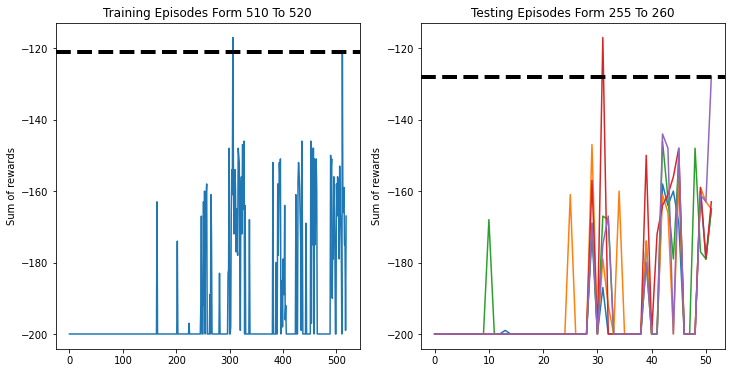

total_reward :  -163.0 ,  Total_Time_step_per_episod :  164.0
total_reward :  -180.0 ,  Total_Time_step_per_episod :  181.0
total_reward :  -181.0 ,  Total_Time_step_per_episod :  182.0
total_reward :  -160.0 ,  Total_Time_step_per_episod :  161.0
total_reward :  -178.0 ,  Total_Time_step_per_episod :  179.0
total_reward :  -160.0 ,  Total_Time_step_per_episod :  161.0
total_reward :  -144.0 ,  Total_Time_step_per_episod :  145.0
total_reward :  -167.0 ,  Total_Time_step_per_episod :  168.0
total_reward :  -145.0 ,  Total_Time_step_per_episod :  146.0
total_reward :  -165.0 ,  Total_Time_step_per_episod :  166.0
The Mean Of test Reward :  -200.0
The test Reward :  [-200.0, -200.0, -200.0, -200.0, -200.0]


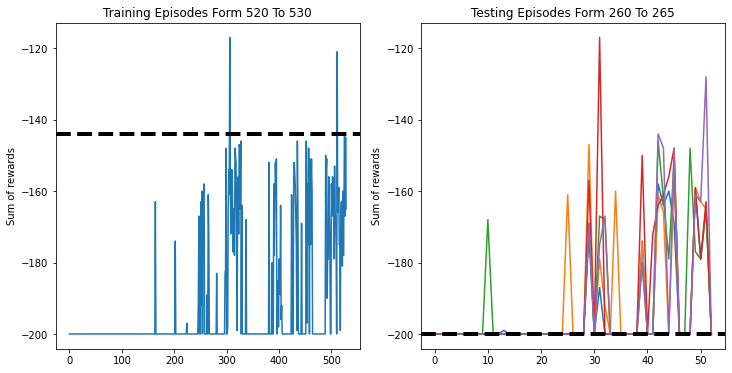

total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -150.0 ,  Total_Time_step_per_episod :  151.0
total_reward :  -153.0 ,  Total_Time_step_per_episod :  154.0
total_reward :  -165.0 ,  Total_Time_step_per_episod :  166.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -178.0 ,  Total_Time_step_per_episod :  179.0
total_reward :  -159.0 ,  Total_Time_step_per_episod :  160.0
total_reward :  -155.0 ,  Total_Time_step_per_episod :  156.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
The Mean Of test Reward :  -178.2
The test Reward :  [-168.0, -200.0, -154.0, -169.0, -200.0]


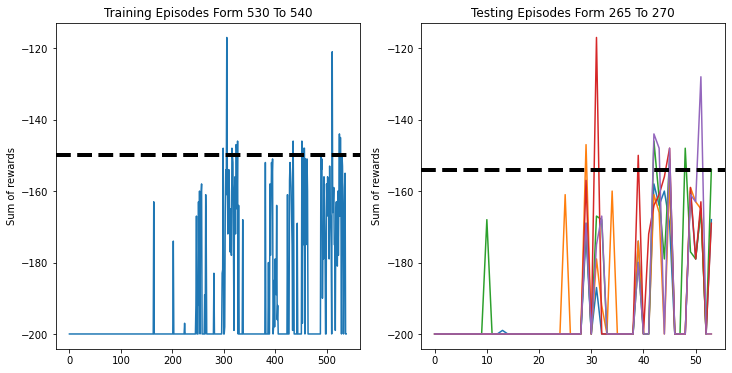

total_reward :  -183.0 ,  Total_Time_step_per_episod :  184.0
total_reward :  -182.0 ,  Total_Time_step_per_episod :  183.0
total_reward :  -153.0 ,  Total_Time_step_per_episod :  154.0
total_reward :  -147.0 ,  Total_Time_step_per_episod :  148.0
total_reward :  -153.0 ,  Total_Time_step_per_episod :  154.0
total_reward :  -151.0 ,  Total_Time_step_per_episod :  152.0
total_reward :  -148.0 ,  Total_Time_step_per_episod :  149.0
total_reward :  -151.0 ,  Total_Time_step_per_episod :  152.0
total_reward :  -153.0 ,  Total_Time_step_per_episod :  154.0
total_reward :  -146.0 ,  Total_Time_step_per_episod :  147.0
The Mean Of test Reward :  -200.0
The test Reward :  [-200.0, -200.0, -200.0, -200.0, -200.0]


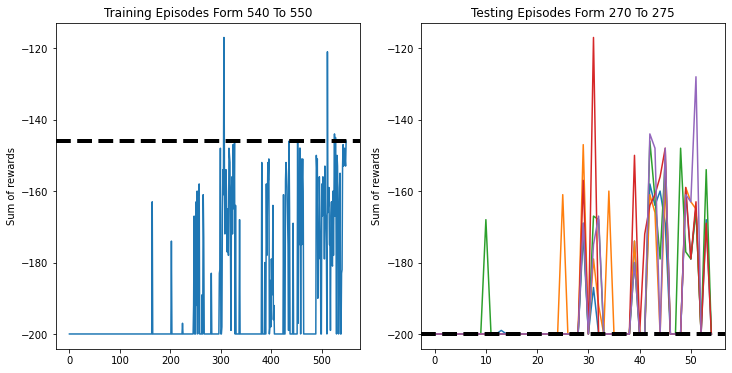

total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -167.0 ,  Total_Time_step_per_episod :  168.0
total_reward :  -149.0 ,  Total_Time_step_per_episod :  150.0
total_reward :  -163.0 ,  Total_Time_step_per_episod :  164.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -158.0 ,  Total_Time_step_per_episod :  159.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
The Mean Of test Reward :  -175.4
The test Reward :  [-200.0, -155.0, -200.0, -122.0, -200.0]


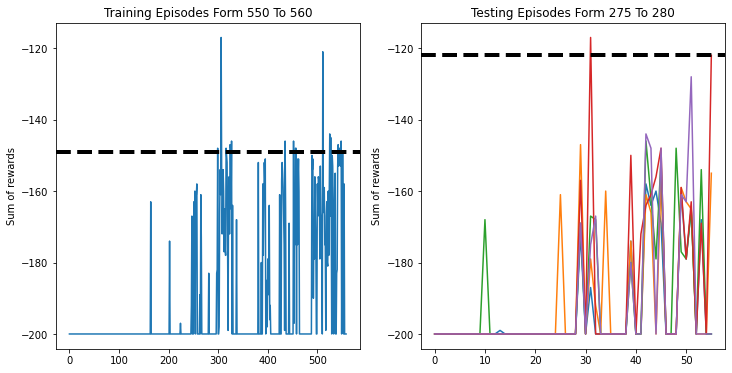

total_reward :  -153.0 ,  Total_Time_step_per_episod :  154.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -199.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -183.0 ,  Total_Time_step_per_episod :  184.0
total_reward :  -179.0 ,  Total_Time_step_per_episod :  180.0
total_reward :  -155.0 ,  Total_Time_step_per_episod :  156.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
The Mean Of test Reward :  -200.0
The test Reward :  [-200.0, -200.0, -200.0, -200.0, -200.0]


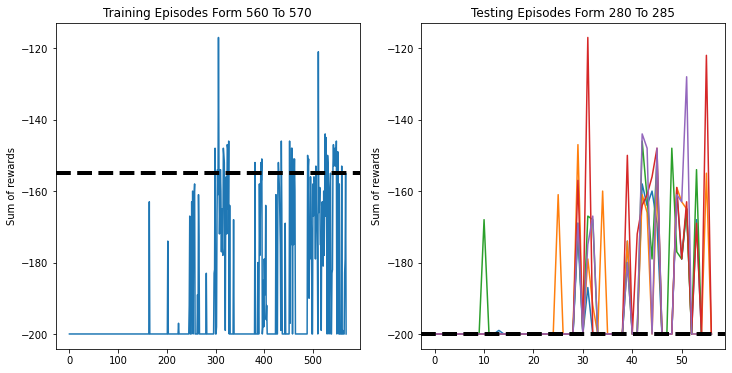

total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
The Mean Of test Reward :  -200.0
The test Reward :  [-200.0, -200.0, -200.0, -200.0, -200.0]


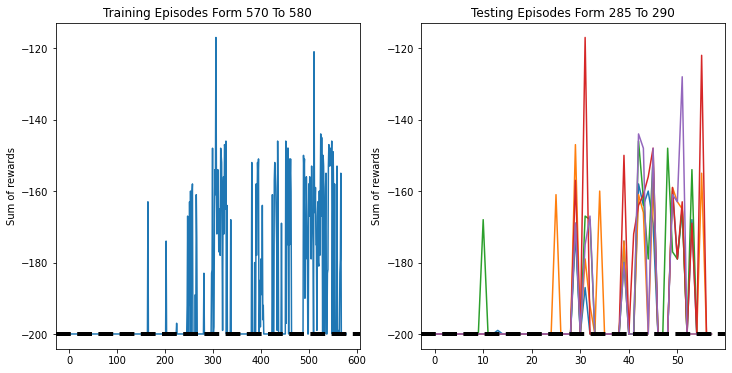

total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
The Mean Of test Reward :  -196.2
The test Reward :  [-200.0, -200.0, -191.0, -191.0, -199.0]


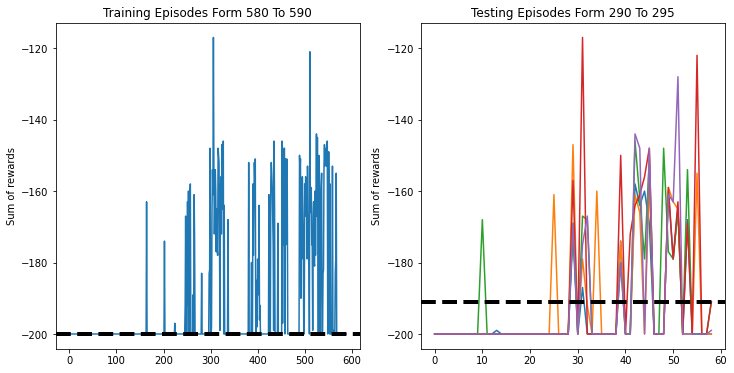

total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -196.0 ,  Total_Time_step_per_episod :  197.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -167.0 ,  Total_Time_step_per_episod :  168.0
total_reward :  -164.0 ,  Total_Time_step_per_episod :  165.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -121.0 ,  Total_Time_step_per_episod :  122.0
The Mean Of test Reward :  -200.0
The test Reward :  [-200.0, -200.0, -200.0, -200.0, -200.0]


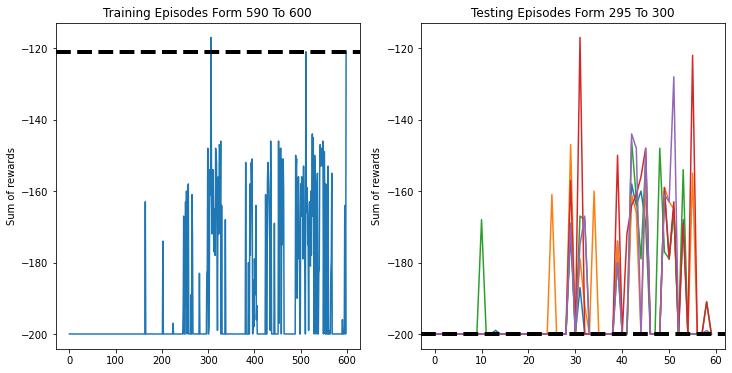

Current episode: 600, success: 57
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -115.0 ,  Total_Time_step_per_episod :  116.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -177.0 ,  Total_Time_step_per_episod :  178.0
total_reward :  -155.0 ,  Total_Time_step_per_episod :  156.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
The Mean Of test Reward :  -200.0
The test Reward :  [-200.0, -200.0, -200.0, -200.0, -200.0]


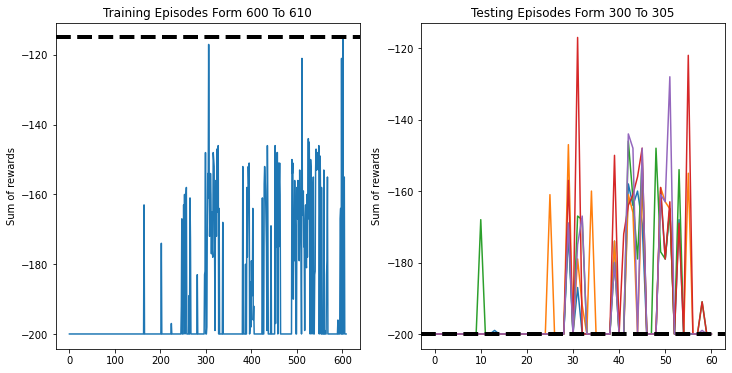

total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
The Mean Of test Reward :  -200.0
The test Reward :  [-200.0, -200.0, -200.0, -200.0, -200.0]


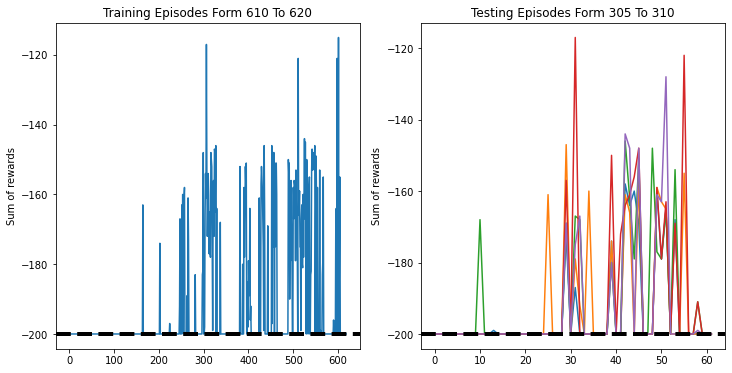

total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -165.0 ,  Total_Time_step_per_episod :  166.0
total_reward :  -165.0 ,  Total_Time_step_per_episod :  166.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
The Mean Of test Reward :  -189.6
The test Reward :  [-200.0, -200.0, -177.0, -171.0, -200.0]


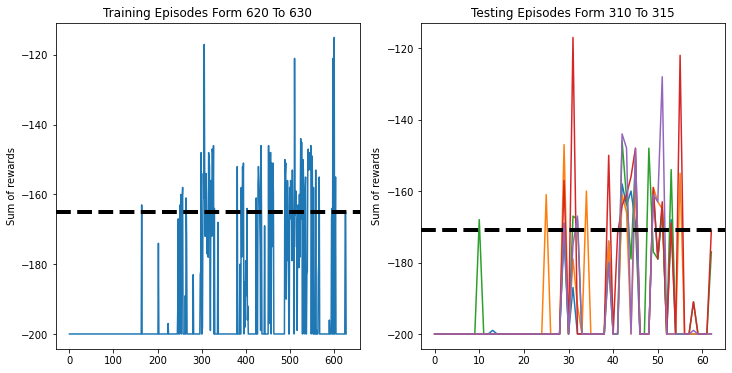

total_reward :  -158.0 ,  Total_Time_step_per_episod :  159.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -165.0 ,  Total_Time_step_per_episod :  166.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -157.0 ,  Total_Time_step_per_episod :  158.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -154.0 ,  Total_Time_step_per_episod :  155.0
The Mean Of test Reward :  -185.4
The test Reward :  [-200.0, -200.0, -200.0, -161.0, -166.0]


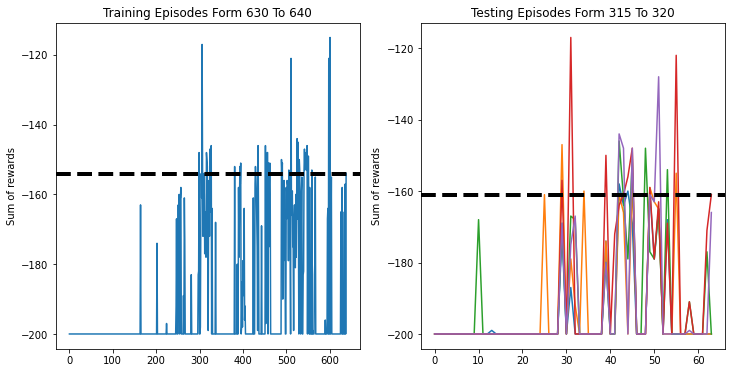

total_reward :  -160.0 ,  Total_Time_step_per_episod :  161.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -161.0 ,  Total_Time_step_per_episod :  162.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -154.0 ,  Total_Time_step_per_episod :  155.0
total_reward :  -158.0 ,  Total_Time_step_per_episod :  159.0
total_reward :  -147.0 ,  Total_Time_step_per_episod :  148.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
The Mean Of test Reward :  -179.2
The test Reward :  [-149.0, -200.0, -200.0, -200.0, -147.0]


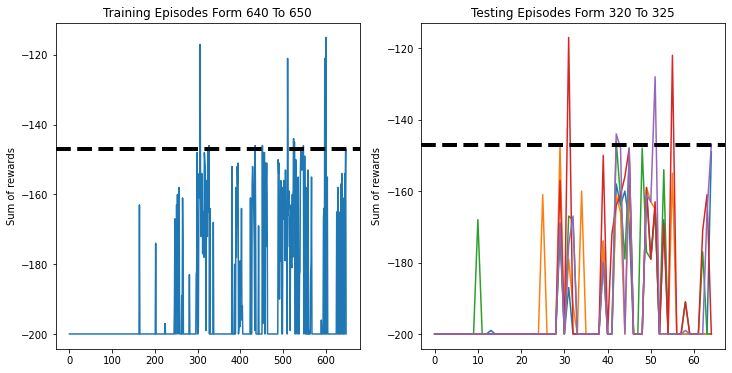

total_reward :  -194.0 ,  Total_Time_step_per_episod :  195.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -147.0 ,  Total_Time_step_per_episod :  148.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -153.0 ,  Total_Time_step_per_episod :  154.0
total_reward :  -149.0 ,  Total_Time_step_per_episod :  150.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -153.0 ,  Total_Time_step_per_episod :  154.0
total_reward :  -159.0 ,  Total_Time_step_per_episod :  160.0
The Mean Of test Reward :  -156.2
The test Reward :  [-157.0, -156.0, -155.0, -158.0, -155.0]


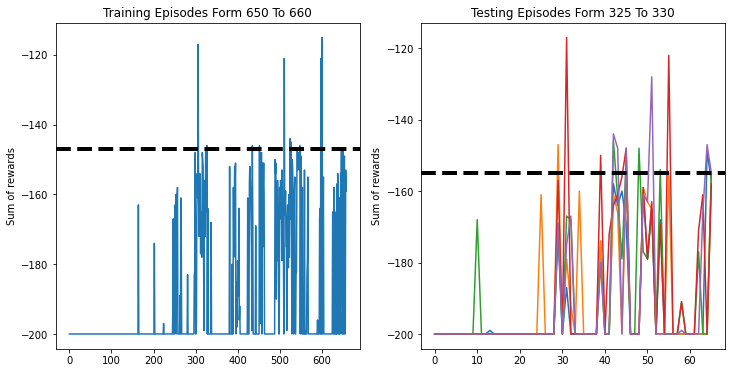

total_reward :  -155.0 ,  Total_Time_step_per_episod :  156.0
total_reward :  -160.0 ,  Total_Time_step_per_episod :  161.0
total_reward :  -154.0 ,  Total_Time_step_per_episod :  155.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -150.0 ,  Total_Time_step_per_episod :  151.0
total_reward :  -151.0 ,  Total_Time_step_per_episod :  152.0
total_reward :  -148.0 ,  Total_Time_step_per_episod :  149.0
total_reward :  -152.0 ,  Total_Time_step_per_episod :  153.0
total_reward :  -157.0 ,  Total_Time_step_per_episod :  158.0
The Mean Of test Reward :  -157.4
The test Reward :  [-157.0, -157.0, -158.0, -158.0, -157.0]


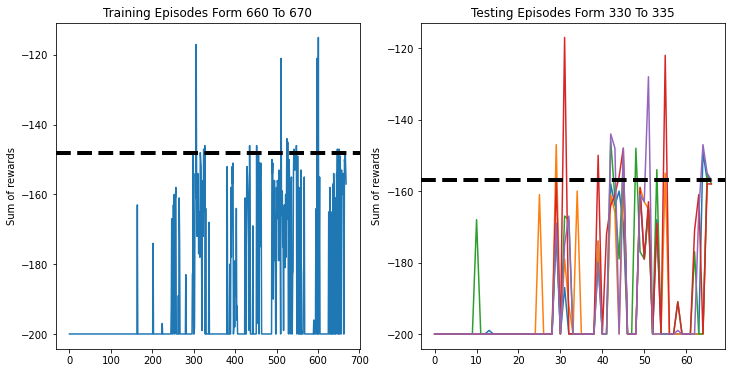

total_reward :  -155.0 ,  Total_Time_step_per_episod :  156.0
total_reward :  -158.0 ,  Total_Time_step_per_episod :  159.0
total_reward :  -156.0 ,  Total_Time_step_per_episod :  157.0
total_reward :  -156.0 ,  Total_Time_step_per_episod :  157.0
total_reward :  -152.0 ,  Total_Time_step_per_episod :  153.0
total_reward :  -168.0 ,  Total_Time_step_per_episod :  169.0
total_reward :  -161.0 ,  Total_Time_step_per_episod :  162.0
total_reward :  -159.0 ,  Total_Time_step_per_episod :  160.0
total_reward :  -167.0 ,  Total_Time_step_per_episod :  168.0
total_reward :  -155.0 ,  Total_Time_step_per_episod :  156.0
The Mean Of test Reward :  -164.0
The test Reward :  [-166.0, -160.0, -168.0, -165.0, -161.0]


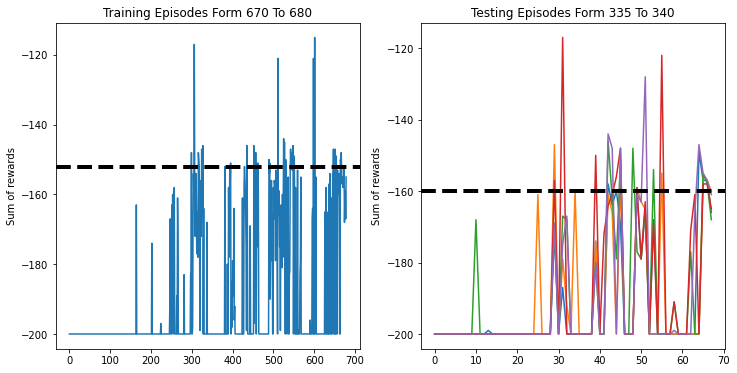

total_reward :  -158.0 ,  Total_Time_step_per_episod :  159.0
total_reward :  -159.0 ,  Total_Time_step_per_episod :  160.0
total_reward :  -154.0 ,  Total_Time_step_per_episod :  155.0
total_reward :  -159.0 ,  Total_Time_step_per_episod :  160.0
total_reward :  -160.0 ,  Total_Time_step_per_episod :  161.0
total_reward :  -158.0 ,  Total_Time_step_per_episod :  159.0
total_reward :  -155.0 ,  Total_Time_step_per_episod :  156.0
total_reward :  -160.0 ,  Total_Time_step_per_episod :  161.0
total_reward :  -167.0 ,  Total_Time_step_per_episod :  168.0
total_reward :  -167.0 ,  Total_Time_step_per_episod :  168.0
The Mean Of test Reward :  -163.6
The test Reward :  [-166.0, -168.0, -161.0, -162.0, -161.0]


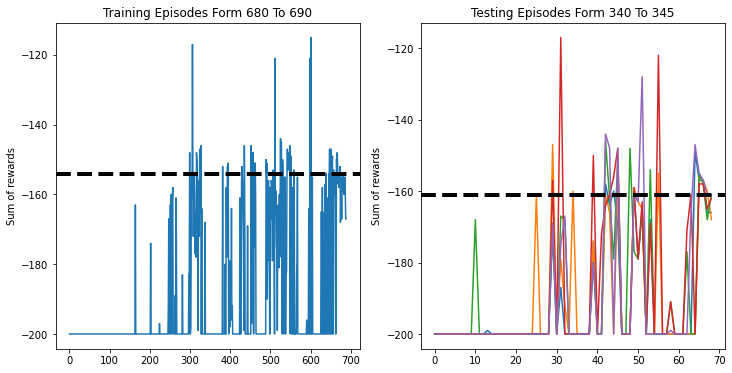

total_reward :  -170.0 ,  Total_Time_step_per_episod :  171.0
total_reward :  -164.0 ,  Total_Time_step_per_episod :  165.0
total_reward :  -162.0 ,  Total_Time_step_per_episod :  163.0
total_reward :  -158.0 ,  Total_Time_step_per_episod :  159.0
total_reward :  -166.0 ,  Total_Time_step_per_episod :  167.0
total_reward :  -162.0 ,  Total_Time_step_per_episod :  163.0
total_reward :  -156.0 ,  Total_Time_step_per_episod :  157.0
total_reward :  -161.0 ,  Total_Time_step_per_episod :  162.0
total_reward :  -155.0 ,  Total_Time_step_per_episod :  156.0
total_reward :  -161.0 ,  Total_Time_step_per_episod :  162.0
The Mean Of test Reward :  -157.8
The test Reward :  [-162.0, -160.0, -155.0, -160.0, -152.0]


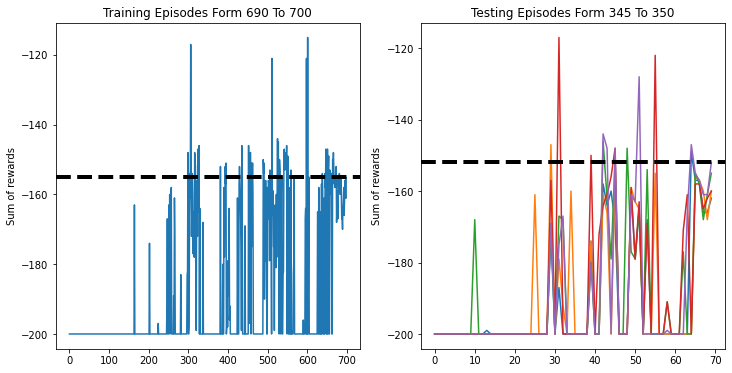

Current episode: 700, success: 58
total_reward :  -151.0 ,  Total_Time_step_per_episod :  152.0
total_reward :  -167.0 ,  Total_Time_step_per_episod :  168.0
total_reward :  -165.0 ,  Total_Time_step_per_episod :  166.0
total_reward :  -160.0 ,  Total_Time_step_per_episod :  161.0
total_reward :  -165.0 ,  Total_Time_step_per_episod :  166.0
total_reward :  -160.0 ,  Total_Time_step_per_episod :  161.0
total_reward :  -164.0 ,  Total_Time_step_per_episod :  165.0
total_reward :  -157.0 ,  Total_Time_step_per_episod :  158.0
total_reward :  -158.0 ,  Total_Time_step_per_episod :  159.0
total_reward :  -169.0 ,  Total_Time_step_per_episod :  170.0
The Mean Of test Reward :  -160.6
The test Reward :  [-159.0, -161.0, -161.0, -163.0, -159.0]


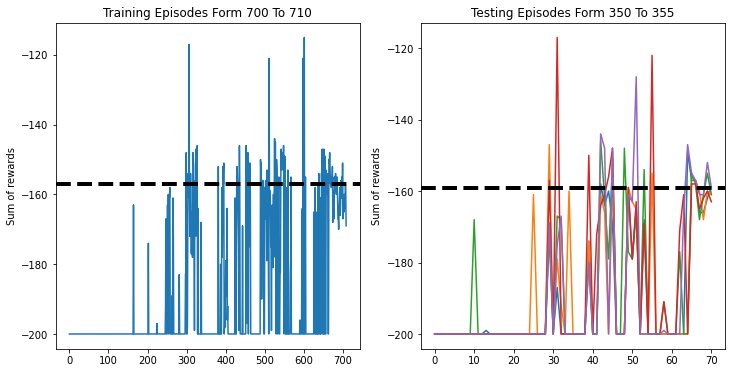

total_reward :  -156.0 ,  Total_Time_step_per_episod :  157.0
total_reward :  -166.0 ,  Total_Time_step_per_episod :  167.0
total_reward :  -163.0 ,  Total_Time_step_per_episod :  164.0
total_reward :  -160.0 ,  Total_Time_step_per_episod :  161.0
total_reward :  -162.0 ,  Total_Time_step_per_episod :  163.0
total_reward :  -165.0 ,  Total_Time_step_per_episod :  166.0
total_reward :  -167.0 ,  Total_Time_step_per_episod :  168.0
total_reward :  -171.0 ,  Total_Time_step_per_episod :  172.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -174.0 ,  Total_Time_step_per_episod :  175.0
The Mean Of test Reward :  -200.0
The test Reward :  [-200.0, -200.0, -200.0, -200.0, -200.0]


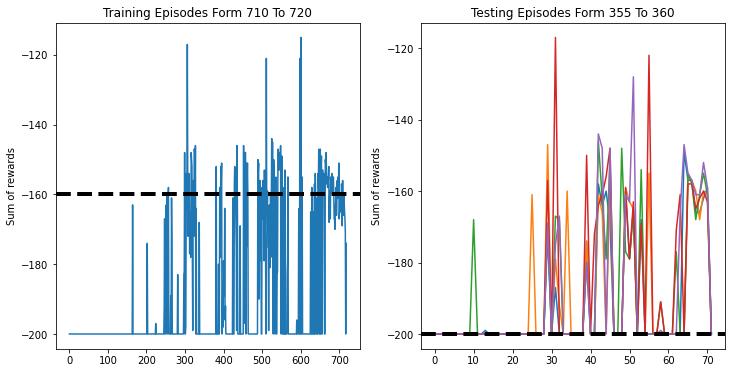

total_reward :  -175.0 ,  Total_Time_step_per_episod :  176.0
total_reward :  -162.0 ,  Total_Time_step_per_episod :  163.0
total_reward :  -160.0 ,  Total_Time_step_per_episod :  161.0
total_reward :  -165.0 ,  Total_Time_step_per_episod :  166.0
total_reward :  -163.0 ,  Total_Time_step_per_episod :  164.0
total_reward :  -160.0 ,  Total_Time_step_per_episod :  161.0
total_reward :  -171.0 ,  Total_Time_step_per_episod :  172.0
total_reward :  -170.0 ,  Total_Time_step_per_episod :  171.0
total_reward :  -173.0 ,  Total_Time_step_per_episod :  174.0
total_reward :  -167.0 ,  Total_Time_step_per_episod :  168.0
The Mean Of test Reward :  -181.8
The test Reward :  [-187.0, -176.0, -181.0, -178.0, -187.0]


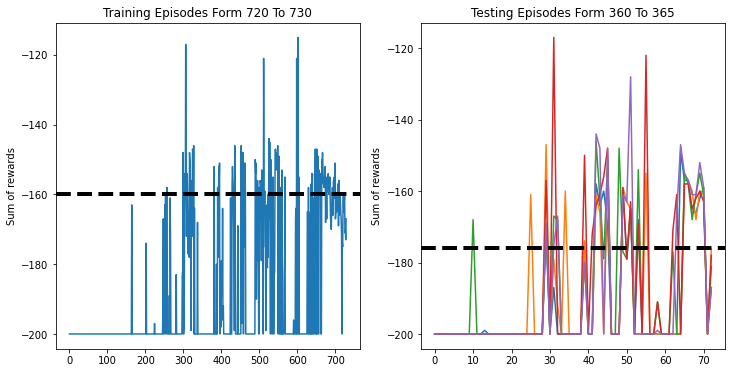

total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -169.0 ,  Total_Time_step_per_episod :  170.0
total_reward :  -171.0 ,  Total_Time_step_per_episod :  172.0
total_reward :  -180.0 ,  Total_Time_step_per_episod :  181.0
total_reward :  -167.0 ,  Total_Time_step_per_episod :  168.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
The Mean Of test Reward :  -200.0
The test Reward :  [-200.0, -200.0, -200.0, -200.0, -200.0]


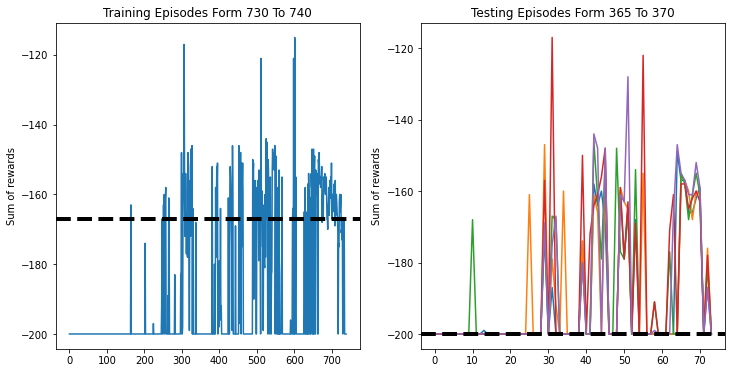

total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -165.0 ,  Total_Time_step_per_episod :  166.0
The Mean Of test Reward :  -176.4
The test Reward :  [-158.0, -161.0, -163.0, -200.0, -200.0]


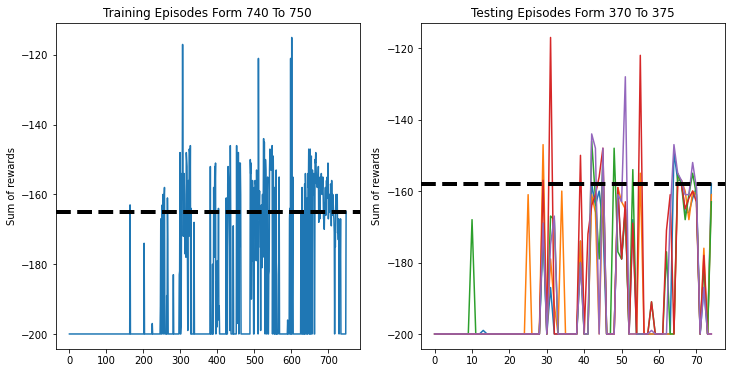

total_reward :  -160.0 ,  Total_Time_step_per_episod :  161.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -166.0 ,  Total_Time_step_per_episod :  167.0
total_reward :  -155.0 ,  Total_Time_step_per_episod :  156.0
total_reward :  -150.0 ,  Total_Time_step_per_episod :  151.0
total_reward :  -161.0 ,  Total_Time_step_per_episod :  162.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
The Mean Of test Reward :  -200.0
The test Reward :  [-200.0, -200.0, -200.0, -200.0, -200.0]


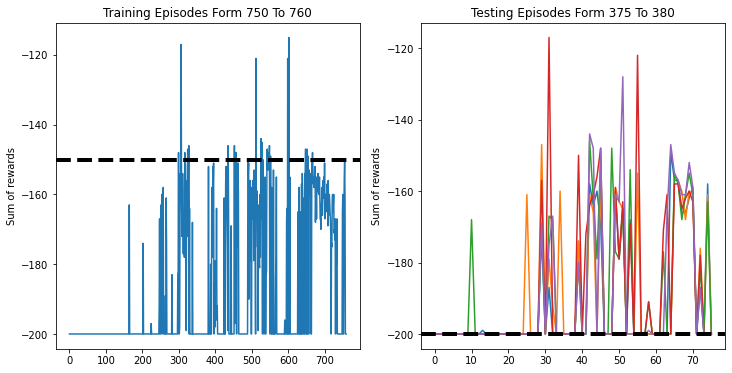

total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -162.0 ,  Total_Time_step_per_episod :  163.0
total_reward :  -155.0 ,  Total_Time_step_per_episod :  156.0
total_reward :  -153.0 ,  Total_Time_step_per_episod :  154.0
total_reward :  -158.0 ,  Total_Time_step_per_episod :  159.0
total_reward :  -158.0 ,  Total_Time_step_per_episod :  159.0
total_reward :  -158.0 ,  Total_Time_step_per_episod :  159.0
total_reward :  -157.0 ,  Total_Time_step_per_episod :  158.0
total_reward :  -157.0 ,  Total_Time_step_per_episod :  158.0
total_reward :  -155.0 ,  Total_Time_step_per_episod :  156.0
The Mean Of test Reward :  -161.2
The test Reward :  [-162.0, -151.0, -167.0, -164.0, -162.0]


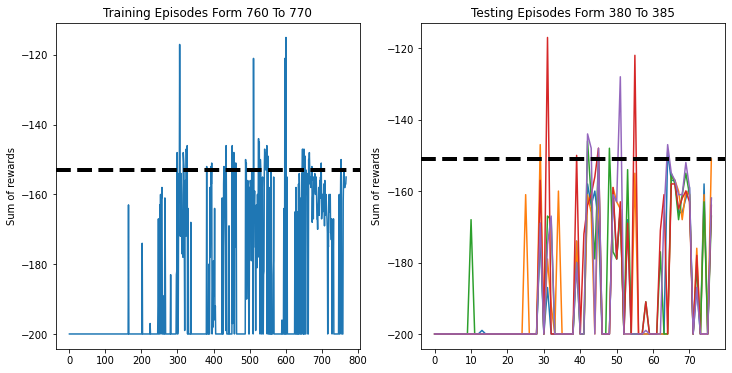

total_reward :  -157.0 ,  Total_Time_step_per_episod :  158.0
total_reward :  -158.0 ,  Total_Time_step_per_episod :  159.0
total_reward :  -160.0 ,  Total_Time_step_per_episod :  161.0
total_reward :  -161.0 ,  Total_Time_step_per_episod :  162.0
total_reward :  -161.0 ,  Total_Time_step_per_episod :  162.0
total_reward :  -174.0 ,  Total_Time_step_per_episod :  175.0
total_reward :  -163.0 ,  Total_Time_step_per_episod :  164.0
total_reward :  -158.0 ,  Total_Time_step_per_episod :  159.0
total_reward :  -160.0 ,  Total_Time_step_per_episod :  161.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
The Mean Of test Reward :  -163.0
The test Reward :  [-175.0, -160.0, -161.0, -161.0, -158.0]


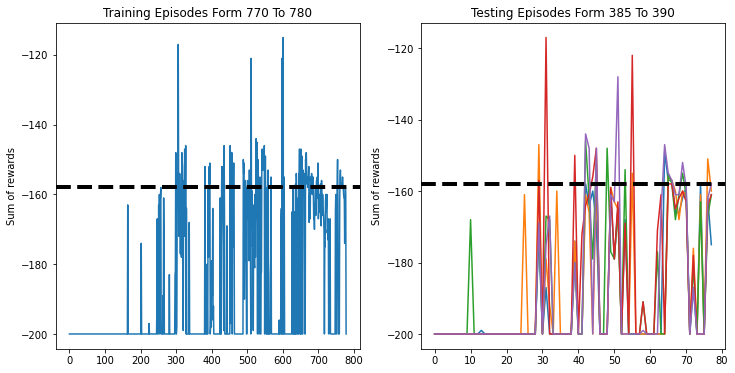

total_reward :  -165.0 ,  Total_Time_step_per_episod :  166.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -170.0 ,  Total_Time_step_per_episod :  171.0
total_reward :  -166.0 ,  Total_Time_step_per_episod :  167.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
The Mean Of test Reward :  -183.4
The test Reward :  [-200.0, -200.0, -173.0, -171.0, -173.0]


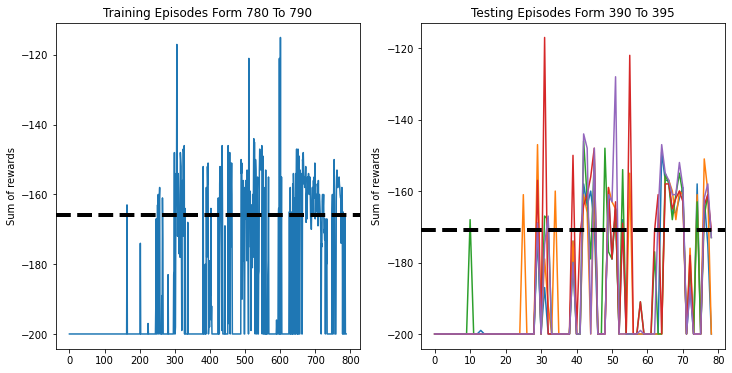

total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
The Mean Of test Reward :  -189.6
The test Reward :  [-175.0, -200.0, -200.0, -173.0, -200.0]


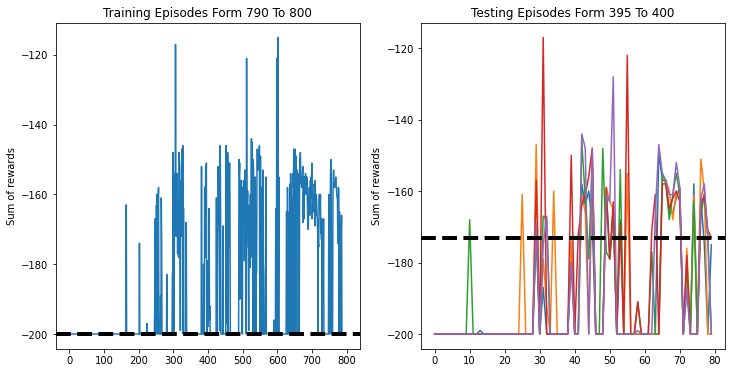

Current episode: 800, success: 60
total_reward :  -173.0 ,  Total_Time_step_per_episod :  174.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -168.0 ,  Total_Time_step_per_episod :  169.0
total_reward :  -179.0 ,  Total_Time_step_per_episod :  180.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
The Mean Of test Reward :  -200.0
The test Reward :  [-200.0, -200.0, -200.0, -200.0, -200.0]


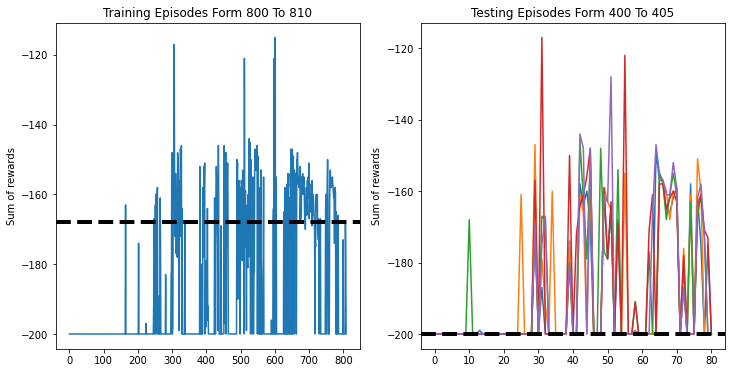

total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -163.0 ,  Total_Time_step_per_episod :  164.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
The Mean Of test Reward :  -200.0
The test Reward :  [-200.0, -200.0, -200.0, -200.0, -200.0]


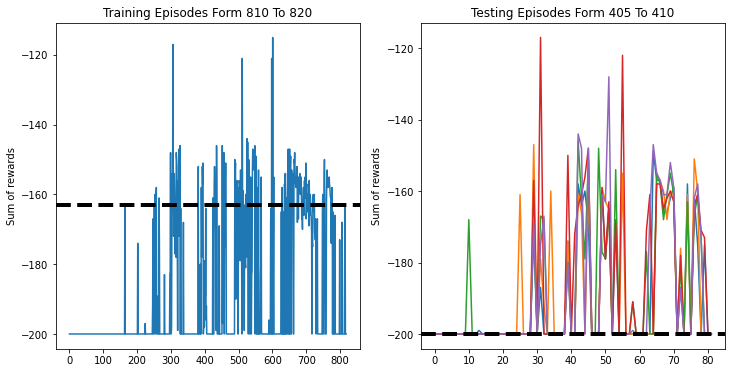

total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -176.0 ,  Total_Time_step_per_episod :  177.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -168.0 ,  Total_Time_step_per_episod :  169.0
The Mean Of test Reward :  -200.0
The test Reward :  [-200.0, -200.0, -200.0, -200.0, -200.0]


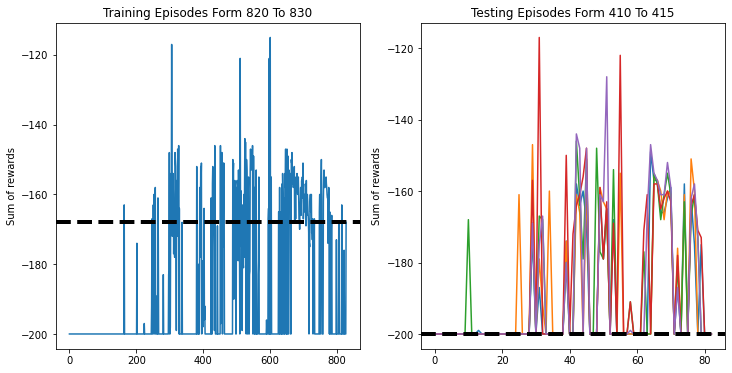

total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -181.0 ,  Total_Time_step_per_episod :  182.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
The Mean Of test Reward :  -200.0
The test Reward :  [-200.0, -200.0, -200.0, -200.0, -200.0]


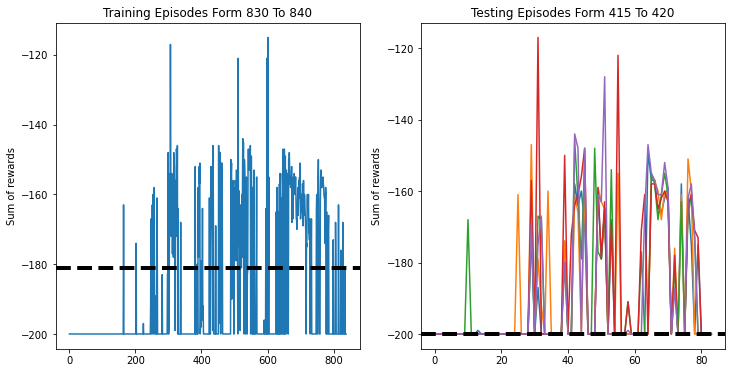

total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -176.0 ,  Total_Time_step_per_episod :  177.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -168.0 ,  Total_Time_step_per_episod :  169.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
The Mean Of test Reward :  -200.0
The test Reward :  [-200.0, -200.0, -200.0, -200.0, -200.0]


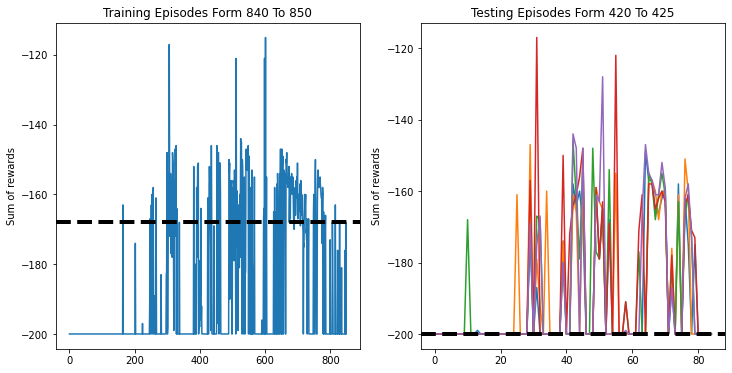

total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -184.0 ,  Total_Time_step_per_episod :  185.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
The Mean Of test Reward :  -185.4
The test Reward :  [-187.0, -184.0, -187.0, -186.0, -183.0]


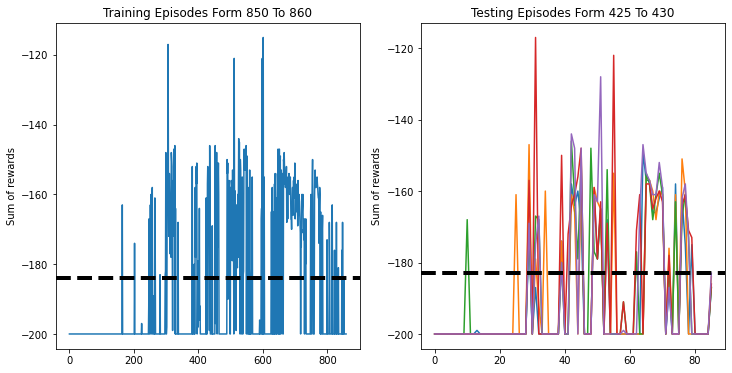

total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -164.0 ,  Total_Time_step_per_episod :  165.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -179.0 ,  Total_Time_step_per_episod :  180.0
total_reward :  -168.0 ,  Total_Time_step_per_episod :  169.0
total_reward :  -171.0 ,  Total_Time_step_per_episod :  172.0
total_reward :  -170.0 ,  Total_Time_step_per_episod :  171.0
total_reward :  -176.0 ,  Total_Time_step_per_episod :  177.0
The Mean Of test Reward :  -163.8
The test Reward :  [-167.0, -164.0, -162.0, -163.0, -163.0]


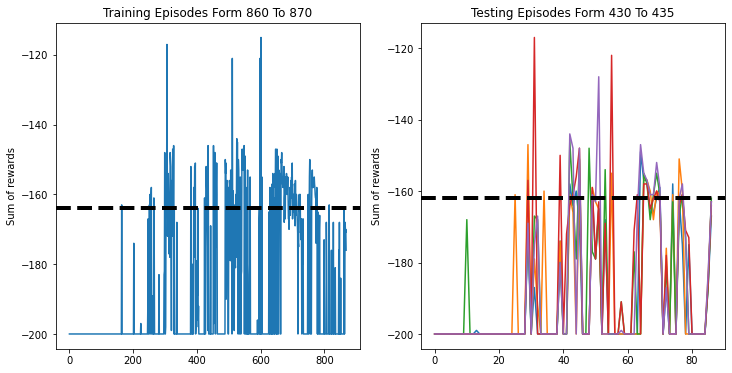

total_reward :  -171.0 ,  Total_Time_step_per_episod :  172.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -179.0 ,  Total_Time_step_per_episod :  180.0
total_reward :  -175.0 ,  Total_Time_step_per_episod :  176.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -169.0 ,  Total_Time_step_per_episod :  170.0
total_reward :  -172.0 ,  Total_Time_step_per_episod :  173.0
The Mean Of test Reward :  -200.0
The test Reward :  [-200.0, -200.0, -200.0, -200.0, -200.0]


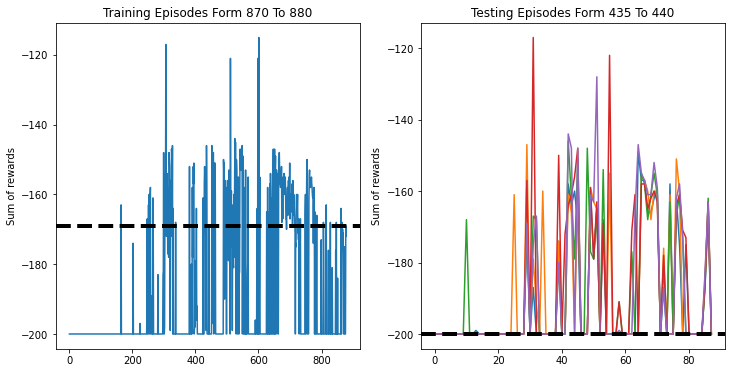

total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
The Mean Of test Reward :  -174.4
The test Reward :  [-175.0, -172.0, -177.0, -173.0, -175.0]


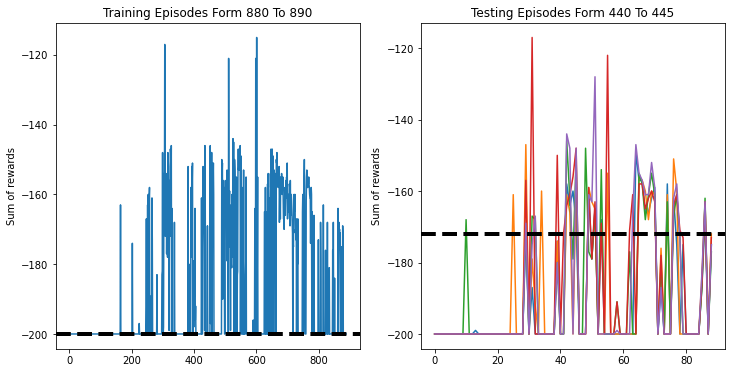

total_reward :  -179.0 ,  Total_Time_step_per_episod :  180.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -163.0 ,  Total_Time_step_per_episod :  164.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -165.0 ,  Total_Time_step_per_episod :  166.0
total_reward :  -167.0 ,  Total_Time_step_per_episod :  168.0
total_reward :  -165.0 ,  Total_Time_step_per_episod :  166.0
total_reward :  -166.0 ,  Total_Time_step_per_episod :  167.0
total_reward :  -170.0 ,  Total_Time_step_per_episod :  171.0
The Mean Of test Reward :  -158.2
The test Reward :  [-158.0, -155.0, -161.0, -160.0, -157.0]


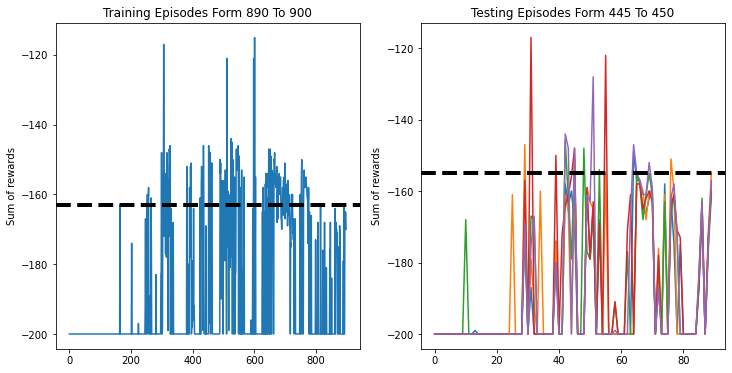

Current episode: 900, success: 28
total_reward :  -161.0 ,  Total_Time_step_per_episod :  162.0
total_reward :  -162.0 ,  Total_Time_step_per_episod :  163.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -172.0 ,  Total_Time_step_per_episod :  173.0
total_reward :  -165.0 ,  Total_Time_step_per_episod :  166.0
total_reward :  -165.0 ,  Total_Time_step_per_episod :  166.0
total_reward :  -172.0 ,  Total_Time_step_per_episod :  173.0
total_reward :  -162.0 ,  Total_Time_step_per_episod :  163.0
The Mean Of test Reward :  -182.4
The test Reward :  [-200.0, -200.0, -151.0, -200.0, -161.0]


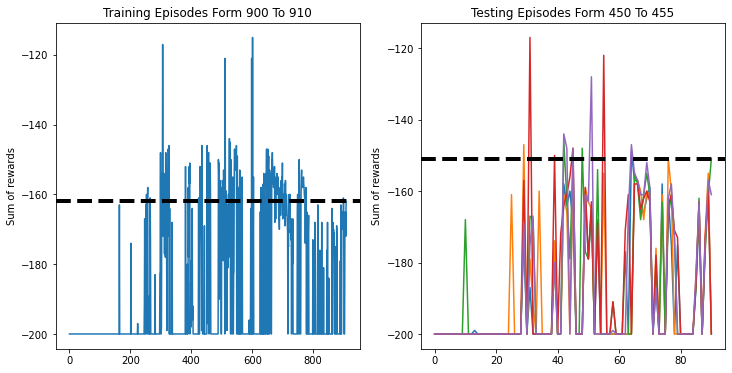

total_reward :  -156.0 ,  Total_Time_step_per_episod :  157.0
total_reward :  -161.0 ,  Total_Time_step_per_episod :  162.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -146.0 ,  Total_Time_step_per_episod :  147.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -160.0 ,  Total_Time_step_per_episod :  161.0
The Mean Of test Reward :  -176.4
The test Reward :  [-171.0, -171.0, -200.0, -180.0, -160.0]


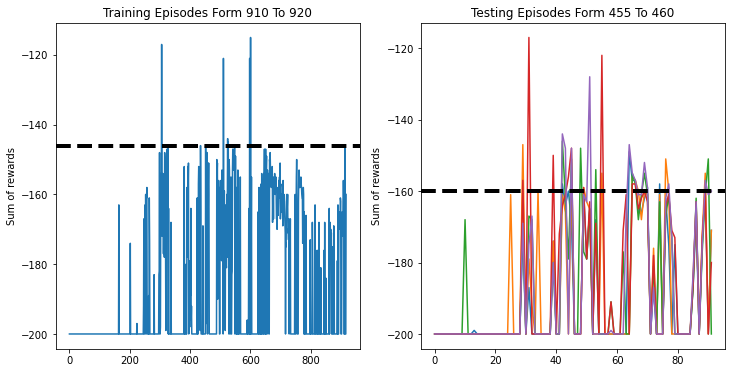

total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -157.0 ,  Total_Time_step_per_episod :  158.0
total_reward :  -154.0 ,  Total_Time_step_per_episod :  155.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -164.0 ,  Total_Time_step_per_episod :  165.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -156.0 ,  Total_Time_step_per_episod :  157.0
The Mean Of test Reward :  -167.0
The test Reward :  [-172.0, -164.0, -163.0, -164.0, -172.0]


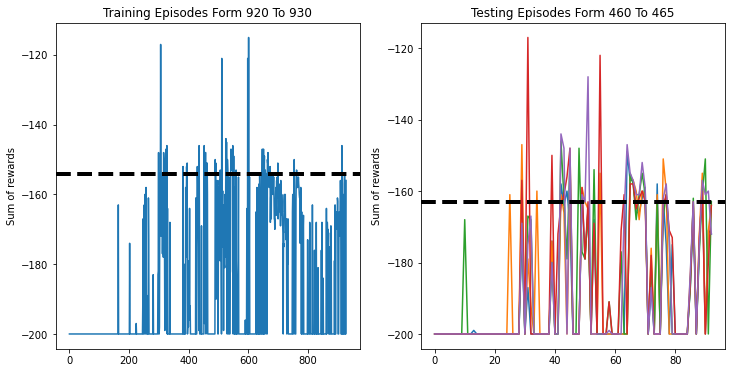

total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -171.0 ,  Total_Time_step_per_episod :  172.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
The Mean Of test Reward :  -153.8
The test Reward :  [-152.0, -153.0, -153.0, -154.0, -157.0]


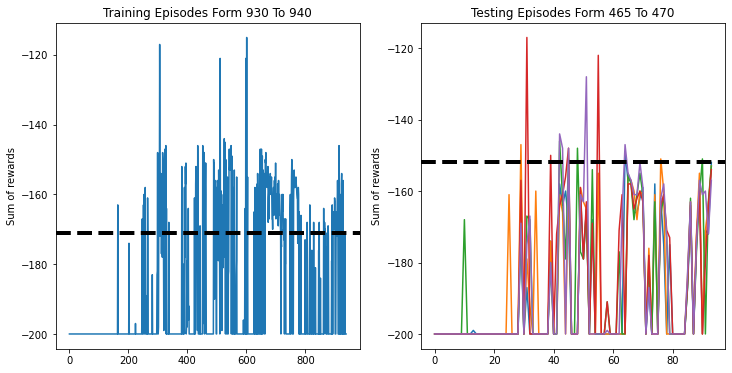

total_reward :  -159.0 ,  Total_Time_step_per_episod :  160.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
The Mean Of test Reward :  -200.0
The test Reward :  [-200.0, -200.0, -200.0, -200.0, -200.0]


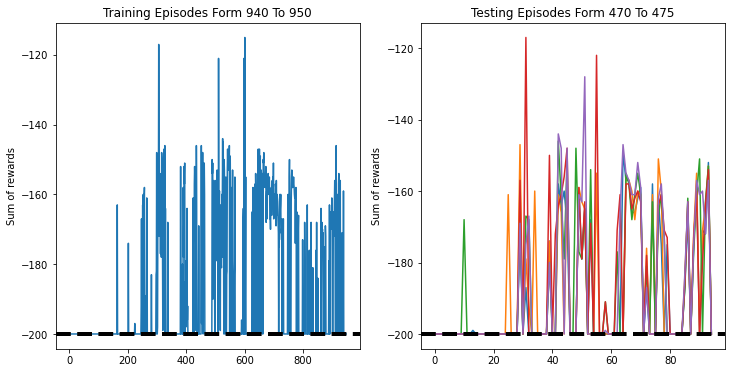

total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
The Mean Of test Reward :  -200.0
The test Reward :  [-200.0, -200.0, -200.0, -200.0, -200.0]


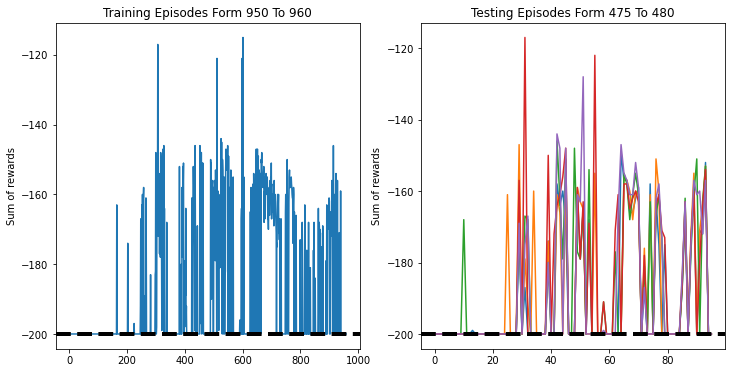

total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
The Mean Of test Reward :  -200.0
The test Reward :  [-200.0, -200.0, -200.0, -200.0, -200.0]


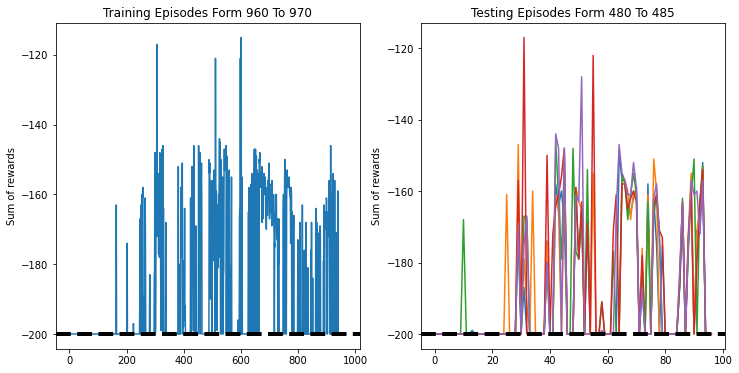

total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -174.0 ,  Total_Time_step_per_episod :  175.0
total_reward :  -168.0 ,  Total_Time_step_per_episod :  169.0
total_reward :  -168.0 ,  Total_Time_step_per_episod :  169.0
total_reward :  -171.0 ,  Total_Time_step_per_episod :  172.0
total_reward :  -171.0 ,  Total_Time_step_per_episod :  172.0
total_reward :  -170.0 ,  Total_Time_step_per_episod :  171.0
total_reward :  -171.0 ,  Total_Time_step_per_episod :  172.0
The Mean Of test Reward :  -161.2
The test Reward :  [-158.0, -162.0, -160.0, -165.0, -161.0]


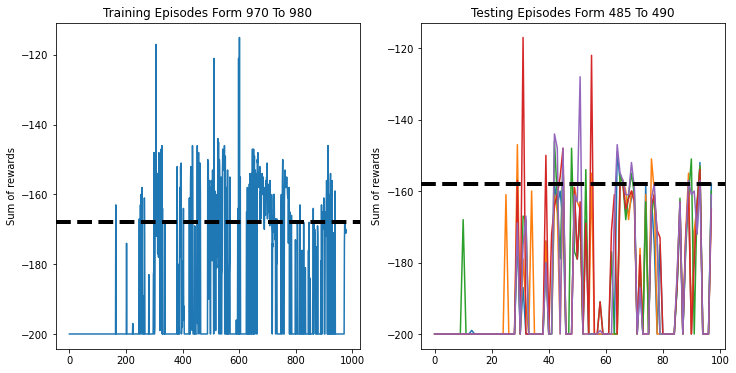

total_reward :  -161.0 ,  Total_Time_step_per_episod :  162.0
total_reward :  -171.0 ,  Total_Time_step_per_episod :  172.0
total_reward :  -163.0 ,  Total_Time_step_per_episod :  164.0
total_reward :  -164.0 ,  Total_Time_step_per_episod :  165.0
total_reward :  -167.0 ,  Total_Time_step_per_episod :  168.0
total_reward :  -168.0 ,  Total_Time_step_per_episod :  169.0
total_reward :  -159.0 ,  Total_Time_step_per_episod :  160.0
total_reward :  -160.0 ,  Total_Time_step_per_episod :  161.0
total_reward :  -166.0 ,  Total_Time_step_per_episod :  167.0
total_reward :  -166.0 ,  Total_Time_step_per_episod :  167.0
The Mean Of test Reward :  -173.8
The test Reward :  [-168.0, -168.0, -167.0, -166.0, -200.0]


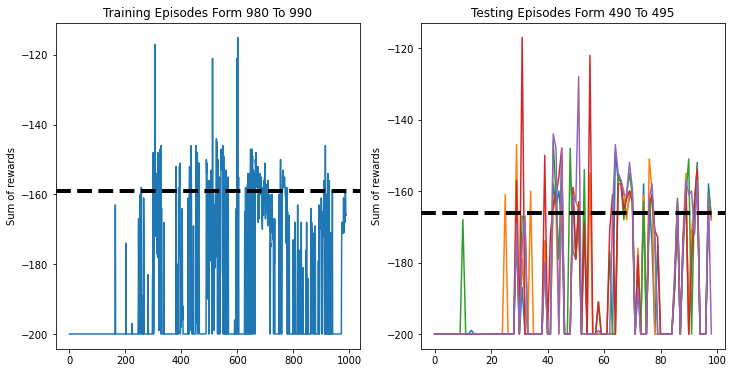

total_reward :  -165.0 ,  Total_Time_step_per_episod :  166.0
total_reward :  -159.0 ,  Total_Time_step_per_episod :  160.0
total_reward :  -157.0 ,  Total_Time_step_per_episod :  158.0
total_reward :  -167.0 ,  Total_Time_step_per_episod :  168.0
total_reward :  -155.0 ,  Total_Time_step_per_episod :  156.0
total_reward :  -200.0 ,  Total_Time_step_per_episod :  200.0
total_reward :  -172.0 ,  Total_Time_step_per_episod :  173.0
total_reward :  -162.0 ,  Total_Time_step_per_episod :  163.0
total_reward :  -169.0 ,  Total_Time_step_per_episod :  170.0
total_reward :  -158.0 ,  Total_Time_step_per_episod :  159.0
The Mean Of test Reward :  -163.4
The test Reward :  [-155.0, -169.0, -166.0, -171.0, -156.0]


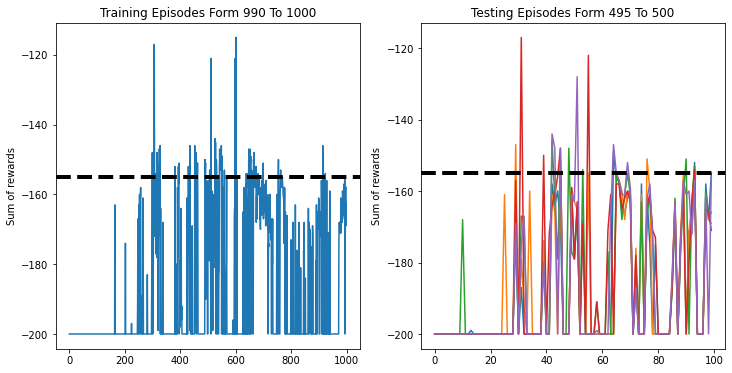

Current episode: 1000, success: 43
total_reward :  -168.0 ,  Total_Time_step_per_episod :  169.0
True


In [ ]:
episode = 0
success_count = 0

if COLAB:
    envTest = wrap_env(gym.make("MountainCar-v0"))
else:
    envTest = gym.make("MountainCar-v0")

total_mean_test_reward = []
best_test_reward = np.NINF
best_q = 0
list_for_res = []
# Loop through the required number of episodes
i = 10; j = 5
while episode < EPISODES:
    episode += 1
    done = False

    # Run the game.  If we are local, display render animation
    # at SHOW_EVERY intervals.

    #this condition to train the model for 10 episodes then test the model for 5 episodes 
    if (episode % 10 == 0) and (episode != 0):
      #test the model
      res = test(q_table, envTest)
      #store mean of all test rewards
      total_mean_test_reward.append(np.mean(res))
      # Store all test rewards
      list_for_res.append(res)
      # select the best q-table and best reward
      if (np.mean(res) > best_test_reward):
        best_q = q_table
        best_test_reward = np.mean(res)
      print('The Mean Of test Reward : ', np.mean(res))
      print('The test Reward : ', res)
      
      #plot the training and testing rewaeds and optimal reward
      plt.figure(figsize=(12, 6))
      plt.subplot(1, 2, 1)
      plt.plot(global_total_reward)
      plt.title("Training Episodes Form "+ str(i-10) + " To " + str(i))
      plt.ylabel("Sum of rewards")
      plt.axhline(max(global_total_reward[(i-10): i]), linewidth = 4, color='k', linestyle='--')

      plt.subplot(1, 2, 2)
      plt.plot(list_for_res)
      plt.title("Testing Episodes Form "+ str(j-5) + " To " + str(j))
      plt.ylabel("Sum of rewards")
      # plt.axhline(max(res))
      plt.axhline(max(res), linewidth = 4, color='k', linestyle='--')
      # plt.plot([0,max(res)], [len(list_for_res),max(res)], "r.") # red line

      plt.show()  

      i += 10
      j += 5
    if episode % SHOW_EVERY == 0:
        print(f"Current episode: {episode}, success: {success_count}")
        success = run_game(q_table, True, False)
        success_count = 0
    else:
        success = run_game(q_table, False, True)

    # Count successes
    if success:
        success_count += 1

    # Move epsilon towards its ending value, if it still needs to move
    if END_EPSILON_DECAYING >= episode >= START_EPSILON_DECAYING:
        epsilon = max(0, epsilon - epsilon_change)

print(success)

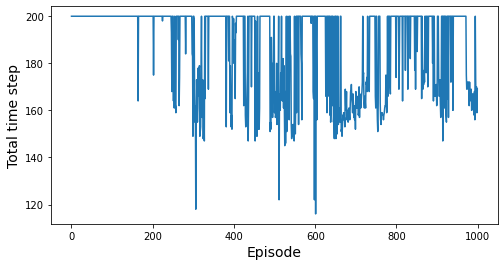

In [ ]:
#plot for the total time step for every episode
plt.figure(figsize=(8, 4))
plt.plot(total_time_step)
plt.xlabel("Episode", fontsize=14)
plt.ylabel("Total time step", fontsize=14)
plt.show()

Text(0.5, 1.0, 'Total Reward vs Episodes')

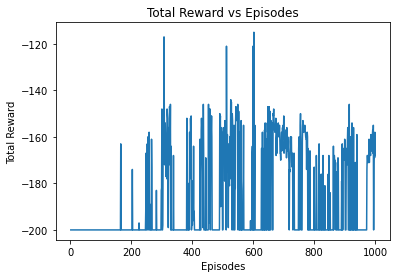

In [ ]:
#plot for the total reward for every episode
plt.plot((np.arange(len(global_total_reward)) + 1), global_total_reward)
plt.xlabel('Episodes')
plt.ylabel('Total Reward')
plt.title('Total Reward vs Episodes')

> As we can see, the number of successful episodes generally increases as training progresses. It is not advisable to stop the first time we observe 100% success over 1,000 episodes. There is a randomness to most games, so it is not likely that an agent would retain its 100% success rate with a new run. It might be safe to stop training once you observe that the agent has gotten 100% for several update intervals.

> ### Running and Observing the Agent

> Now that the algorithm has trained the agent, we can observe the agent in action. 

In [ ]:
if COLAB:
    envPlay = wrap_env(gym.make("MountainCar-v0"))
else:
    envPlay = gym.make("MountainCar-v0")

#running the agent by using the optimal q-table
play(best_q, envPlay)
show_video()

> ### Inspecting the Q-Table

> We can also display the Q-table. The following code shows the agent's action for each environment state. As the weights of a neural network, this table is not straightforward to interpret. Some patterns do emerge in that direction, as seen by calculating the means of rows and columns. The actions seem consistent at both velocity and position's upper and lower halves.

In [ ]:
df_best = pd.DataFrame(best_q.argmax(axis=2))

df_best.columns = [f'v-{x}' for x in range(DISCRETE_GRID_SIZE[0])]
df_best.index = [f'p-{x}' for x in range(DISCRETE_GRID_SIZE[1])]
df_best


,v-0,v-1,v-2,v-3,v-4,v-5,v-6,v-7,v-8,v-9
p-0,0,1,1,2,1,1,2,0,2,1
p-1,0,2,0,1,2,2,2,2,0,1
p-2,1,0,0,0,0,2,1,1,2,2
p-3,0,0,2,0,0,0,2,2,2,2
p-4,2,2,0,0,0,1,2,2,2,1
p-5,0,1,1,0,1,0,1,2,2,0
p-6,0,0,1,1,0,0,2,1,1,1
p-7,1,1,1,2,1,1,2,2,0,1
p-8,0,2,1,1,1,2,2,2,1,1
p-9,0,1,2,2,2,0,2,0,1,2


Text(0, 0.5, 'velocity')

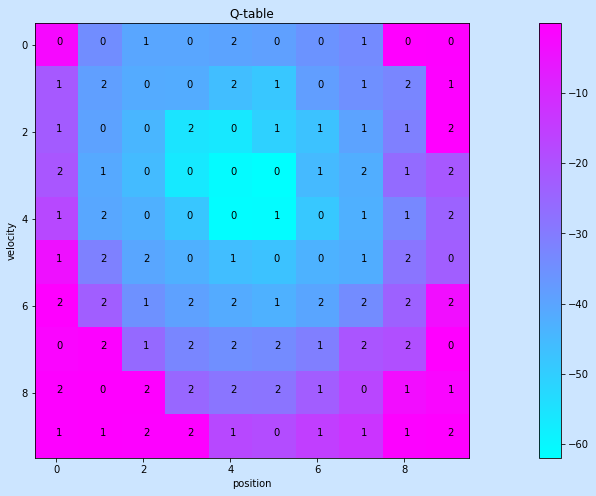

In [ ]:
# Visualize best Q-Table for each state and corresponding action
q_image = np.max(best_q, axis=2)       # max Q-value for each state
q_actions = np.argmax(best_q, axis=2)  # best action for each state

plt.figure(figsize=(25, 8), facecolor='#CCE5FF')
plt.imshow(q_image, cmap='cool');
plt.colorbar()
for x in range(q_image.shape[0]):
    for y in range(q_image.shape[1]):
        plt.text(x, y, q_actions[x, y], color='k')
plt.grid(False)
plt.title('Q-table')
plt.xlabel('position')
plt.ylabel('velocity')

> # Deep Q-Network (DQN) from scratch

> Imports Some packages

In [ ]:
!pip install pygame==2.0.0.dev20

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 11.6 MB 9.5 MB/s 


In [ ]:
%tensorflow_version 1.x

TensorFlow 1.x selected.


In [ ]:
!pip install gym==0.22

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 631 kB 8.3 MB/s 
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
    Preparing wheel metadata ... done
  Created wheel for gym: filename=gym-0.22.0-py3-none-any.whl size=708394 sha256=af122cbe474f651d7f9fe94681ebc640ba86ca2d869f78cfb6244a9ba039a3a7
  Stored in directory: /root/.cache/pip/wheels/7d/5e/87/7d50e0179edda70feff5bba05c381041e1c1fd80c6b06a4cc3
Successfully built gym
  Attempting uninstall: gym
    Found existing installation: gym 0.17.3
    Uninstalling gym-0.17.3:
      Successfully uninstalled gym-0.17.3


> ## Imports

In [ ]:
# Import OpenAI Gym
import gym
import os
import datetime
import itertools
import collections
import numpy as np
import matplotlib.pyplot as plt

# Initialise TensorFlow
import tensorflow as tf
import helpers
import importlib

# To plot pretty figures
%matplotlib inline
import matplotlib as mpl
import matplotlib.pyplot as plt
mpl.rc('axes', labelsize=14)
mpl.rc('xtick', labelsize=12)
mpl.rc('ytick', labelsize=12)

# To get smooth animations
import matplotlib.animation as animation
mpl.rc('animation', html='jshtml')

In [ ]:
gpu_options = tf.GPUOptions(allow_growth=True)  # init TF ...
config=tf.ConfigProto(gpu_options=gpu_options)  # w/o taking ...
with tf.Session(config=config): pass            # all GPU memory

> Import helpers for plotting , file named : helpers.py

In [ ]:
importlib.reload(helpers);

> ## Q-Learning

> Epsilon random policy

In [ ]:
def policy(st, model, eps):
    if np.random.rand() > eps:
        q_values = model.eval(np.stack([st]))
        return np.argmax(q_values)
    else:
        return env.action_space.sample()

> Main training loop. Supports resuming from pre-trained agent and callbacks.

In [ ]:
def q_learning(env, frames, gamma, eps_decay_steps, eps_target,
               batch_size, model, mem, start_step=0,
               callback=None, trace=None, render=False):
    # Q-Learning, supprots resume
    
    # Note: If resuming, all parameters should be identical to original call, with
    #     exception of 'start_step' and 'frames'.
    
    # Params:
    #     env - environment
    #     frames - number of time steps to execute
    #     gamma - discount factor [0..1]
    #     eps_decay_steps - decay epsilon-greedy param over that many time steps
    #     eps_target - epsilon-greedy param after decay
    #     batch_size - neural network batch size from memory buffer
    #     model      - function approximator, already initialised, with methods:
    #                  eval(state, action) -> float
    #                  train(state, target) -> None
    #     mem - memory reply buffer
    #     start_step - if continuning, pass in return value (tts_) here
    #     callback - optional callback to execute
    #     trace - this object handles data logging, plotting etc.
    #     render - render openai gym environment?
    
    
    def eps_schedule(tts, eps_decay_steps, eps_target):
        if tts > eps_decay_steps:
            return eps_target
        else:
            eps_per_step_change = (1-eps_target) / eps_decay_steps
            return 1.0 - tts * eps_per_step_change
    
        
    assert len(mem) >= batch_size
    
    tts_ = start_step                        # total time step
    for _ in itertools.count():              # count from 0 to infinity
        
        S = env.reset()
        episode_reward = 0                   # purely for logging
        if render: env.render()
        
        for t_ in itertools.count():         # count from 0 to infinity
            
            eps = eps_schedule(tts_, eps_decay_steps, eps_target)
            
            A = policy(S, model, eps)
            
            S_, R, done, _ = env.step(A)
            episode_reward += R
            if render: env.render()
            
            mem.append(S, A, R, S_, done)
            
            if callback is not None:
                callback(tts_, t_, S, A, R, done, eps, episode_reward, model, mem, trace)
            
            states, actions, rewards, n_states, dones, _ = mem.get_batch(batch_size)
            targets = model.eval(n_states)
            targets = rewards + gamma * np.max(targets, axis=-1)
            targets[dones] = rewards[dones]  # return of next-to-terminal state is just R
            model.train(states, actions, targets)

            S = S_
            
            tts_ += 1
            if tts_ >= start_step + frames:
                return tts_                  # so we can pick up where we left
            
            if done:
                break

> Stripped down version for evaluation. Does not train agent.

In [ ]:
def evaluate(env, model, frames=None, episodes=None, eps=0.0, render=False):
    assert frames is not None or episodes is not None
        
    total_reward = 0
    
    tts_ = 0                                 # total time step
    for e_ in itertools.count():             # count from 0 to infinity
        if episodes is not None and e_ >= episodes:
            return total_reward
        
        S = env.reset()
        if render: env.render()
        
        for t_ in itertools.count():         # count from 0 to infinity
            
            A = policy(S, model, eps)
            
            S_, R, done, _ = env.step(A)
            total_reward += R
            if render: env.render()
    
            S = S_
            
            tts_ += 1
            if frames is not None and tts_ >= frames:
                return
            
            if done:
                break

> Stripped down version to pre-fill memory buffer with random policy.

In [ ]:
def mem_fill(env, mem, steps=None, episodes=None, render=False):
        
    # Fill memory buffer using random policy
    tts_ = 0
    for e_ in itertools.count():
        if episodes is not None and e_ >= episodes:
            return
        
        S = env.reset();
        if render: env.render()
        
        for t_ in itertools.count():
        
            A = env.action_space.sample()    # random policy
            S_, R, done, _ = env.step(A)
            if render: env.render()
                
            mem.append(S, A, R, S_, done)
            
            S = S_
            
            tts_ += 1
            if steps is not None and tts_ >= steps:
                return
            
            if done:
                break

> ### Function Approximators and Memory 


> Definition of simple neural network with two hidden layers. As as side note, for classic control tasks tilings work much better.

In [ ]:
class TFNeuralNet():
    def __init__(self, nb_in, nb_hid_1, nb_hid_2, nb_out, lr):
        self.nb_in = nb_in
        self.nb_hid_1 = nb_hid_1
        self.nb_hid_2 = nb_hid_2
        self.nb_out = nb_out
        
        tf.reset_default_graph()
              
        self._x = tf.placeholder(name='xx', shape=[None, nb_in], dtype=tf.float32)
        self._y = tf.placeholder(name='yy', shape=[None, nb_out], dtype=tf.float32)

        self._h_hid_1 = tf.layers.dense(self._x, units=nb_hid_1,
                                        activation=tf.nn.relu, name='Hidden_1')
        self._h_hid_2 = tf.layers.dense(self._h_hid_1, units=nb_hid_2,
                                        activation=tf.nn.relu, name='Hidden_2')
        self._y_hat = tf.layers.dense(self._h_hid_2, units=nb_out,
                                      activation=None, name='Output')
        self._loss = tf.losses.mean_squared_error(self._y, self._y_hat)

        self._optimizer = tf.train.RMSPropOptimizer(learning_rate=lr)
        self._train_op = self._optimizer.minimize(self._loss)

        self._sess = tf.Session()
        self._sess.run(tf.global_variables_initializer())
        
    def backward(self, x, y):
        assert x.ndim == y.ndim == 2
        _, y_hat, loss = self._sess.run([self._train_op, self._y_hat, self._loss],
                                         feed_dict={self._x: x, self._y:y})
        return y_hat, loss
    
    def forward(self, x):
        return self._sess.run(self._y_hat, feed_dict={self._x: x})
    
    def save(self, filepath):
        saver = tf.train.Saver()
        saver.save(self._sess, filepath)
        
    def load(self, filepath):
        saver = tf.train.Saver()
        saver.restore(self._sess, filepath)


> Function approximator wrapper. Mostly performs sanity check and input/output normalisation.

In [ ]:
class TFFunctApprox():

    def __init__(self, model, st_low, st_high, rew_mean, rew_std, nb_actions):
        # Q-function approximator using Keras model

        # Args:
        #     model: TFNeuralNet model
        
        st_low = np.array(st_low);
        st_high = np.array(st_high)
        self._model = model
        
        assert st_low.ndim == 1 and st_low.shape == st_high.shape
        
        if len(st_low) != model.nb_in:
            raise ValueError('Input shape does not match state_space shape')

        if nb_actions != model.nb_out:
            raise ValueError('Output shape does not match action_space shape')

        # normalise inputs
        self._offsets = st_low + (st_high - st_low) / 2
        self._scales = 1 / ((st_high - st_low) / 2)
        
        self._rew_mean = rew_mean
        self._rew_std = rew_std

    def eval(self, states):
        assert isinstance(states, np.ndarray)
        assert states.ndim == 2

        inputs = (states - self._offsets) * self._scales

        y_hat = self._model.forward(inputs)
        
        #return y_hat
        return y_hat*self._rew_std + self._rew_mean

    def train(self, states, actions, targets):
        
        assert isinstance(states, np.ndarray)
        assert isinstance(actions, np.ndarray)
        assert isinstance(targets, np.ndarray)
        assert states.ndim == 2
        assert actions.ndim == 1
        assert targets.ndim == 1
        assert len(states) == len(actions) == len(targets)
        
        
        targets = (targets-self._rew_mean) / self._rew_std    # normalise

        inputs = (states - self._offsets) * self._scales
        all_targets = self._model.forward(inputs)       # this should normalised already
        all_targets[np.arange(len(all_targets)), actions] = targets
        self._model.backward(inputs, all_targets)


> ## Memory Class

> We'll be using experience replay memory for training our DQN. It stores
the transitions that the agent observes, allowing us to reuse this data
later. By sampling from it randomly, the transitions that build up a
batch are decorrelated. It has been shown that this greatly stabilizes
and improves the DQN training procedure.

> Note: Memory reply buffer. Reasonably fast impl., doesn't do memory copies when picking batches. This will be useful for Atari. Python deque is very slow.

In [ ]:
class Memory:
    # Circular buffer for DQN memory reply. Fairly fast.

    def __init__(self, max_len, state_shape, state_dtype):
        
        # Args:
        #     max_len: maximum capacity
        
        assert isinstance(max_len, int)
        assert max_len > 0

        self.max_len = max_len                      # maximum length        
        self._curr_insert_ptr = 0                   # index to insert next data sample
        self._curr_len = 0                          # number of currently stored elements

        state_arr_shape = [max_len] + list(state_shape)

        self._hist_St = np.zeros(state_arr_shape, dtype=state_dtype)
        self._hist_At = np.zeros(max_len, dtype=int)
        self._hist_Rt_1 = np.zeros(max_len, dtype=float)
        self._hist_St_1 = np.zeros(state_arr_shape, dtype=state_dtype)
        self._hist_done_1 = np.zeros(max_len, dtype=bool)

    def append(self, St, At, Rt_1, St_1, done_1):
        # Add one sample to memory, override oldest if max_len reached.

        # Args:
        #     St [np.ndarray]   - state
        #     At [int]          - action
        #     Rt_1 [float]      - reward
        #     St_1 [np.ndarray] - next state
        #     done_1 [bool]       - next state terminal?
        
        self._hist_St[self._curr_insert_ptr] = St
        self._hist_At[self._curr_insert_ptr] = At
        self._hist_Rt_1[self._curr_insert_ptr] = Rt_1
        self._hist_St_1[self._curr_insert_ptr] = St_1
        self._hist_done_1[self._curr_insert_ptr] = done_1
        
        if self._curr_len < self.max_len:                 # keep track of current length
            self._curr_len += 1
            
        self._curr_insert_ptr += 1                        # increment insertion pointer
        if self._curr_insert_ptr >= self.max_len:         # roll to zero if needed
            self._curr_insert_ptr = 0

    def __len__(self):
        # Number of samples in memory, 0 <= length <= max_len
        return self._curr_len

    def get_batch(self, batch_len):
        # Sample batch of data, with repetition

        # Args:
        #     batch_len: nb of samples to pick

        # Returns:
        #     states, actions, rewards, next_states, next_done, indices
        #     Each returned element is np.ndarray with length == batch_len
        
        assert self._curr_len > 0
        assert batch_len > 0

        # randint much faster than np.random.sample
        indices = np.random.randint(low=0, high=self._curr_len, size=batch_len, dtype=int)

        states = np.take(self._hist_St, indices, axis=0)
        actions = np.take(self._hist_At, indices, axis=0)
        rewards_1 = np.take(self._hist_Rt_1, indices, axis=0)
        states_1 = np.take(self._hist_St_1, indices, axis=0)
        dones_1 = np.take(self._hist_done_1, indices, axis=0)

        return states, actions, rewards_1, states_1, dones_1, indices


    
    def pick_last(self, nb):
        # Pick last nb elements from memory
        
        # Returns:
        #     states, actions, rewards, next_states, done_1, indices
        #     Each returned element is np.ndarray with length == batch_len
        
        assert nb <= self._curr_len
        
        start = self._curr_insert_ptr - nb                # inclusive
        end = self._curr_insert_ptr                       # not inclusive
        indices = np.array(range(start,end), dtype=int)   # indices to pick, can be neg.
        indices[indices < 0] += self._curr_len            # loop negative to positive
        
        states = np.take(self._hist_St, indices, axis=0)
        actions = np.take(self._hist_At, indices, axis=0)
        rewards_1 = np.take(self._hist_Rt_1, indices, axis=0)
        states_1 = np.take(self._hist_St_1, indices, axis=0)
        dones_1 = np.take(self._hist_done_1, indices, axis=0)
        
        return states, actions, rewards_1, states_1, dones_1, indices
    

> ### Experiment Setup


> Environment wrapper to skip frames. Also known as action repeat. Really helps with some environments, e.g. mountain car.

In [ ]:
class WrapFrameSkip():
    def __init__(self, env, frameskip):
        assert frameskip >= 1
        self._env = env
        self._frameskip = frameskip
        self.observation_space = env.observation_space
        self.action_space = env.action_space
    
    def reset(self):
        return self._env.reset()
    
    def step(self, action):
        sum_rew = 0
        for _ in range(self._frameskip):
            obs, rew, done, info = self._env.step(action)
            sum_rew += rew
            if done: break
        return obs, sum_rew, done, info
    
    def render(self, mode='human'):
        return self._env.render(mode=mode)
        
    def close(self):
        self._env.close()    

> This object is a basic data logger. If you don't want to generate plots, you can mostly ignore it.

In [ ]:
class Trace():
    def __init__(self, eval_every, render=False, test_states=None, state_labels=None):
        
        if test_states is not None:
            assert test_states.ndim == 2
            
        self.enable_plotting = False
        
        self.eval_every = eval_every
        self.test_states = test_states
        self.state_labels = state_labels
        
        self.tstep = 0
        self.total_tstep = 0
        
        self.q_values = collections.OrderedDict()
        self.ep_rewards = collections.defaultdict(float)
        self.last_ep_reward = None
        
        self.states = []
        self.actions = []
        self.rewards = []  # t+1
        self.dones = []    # t+1
        self.epsilons = []

> Callback which is called every single training iteration, it does as follows:

> *  fill up trace object with basic logging data
> *  print training progress
> *  perform evaluation of test_states
> *  optionally plot agent state

In [ ]:
def callback(total_time_step, tstep, st, act, rew_, done_,
             eps, ep_reward, model, memory, trace):
    # Called from gradient_MC after every episode.
    
    # Params:
    #     episode [int] - episode number
    #     tstep [int]   - timestep within episode
    #     model [obj]   - function approximator
    #     trace [list]  - list to write results to
    
    assert total_time_step == trace.total_tstep
    
    trace.tstep = tstep
    
    trace.states.append(st)
    trace.actions.append(act)
    trace.rewards.append(rew_)
    trace.dones.append(done_)
    trace.epsilons.append(eps)
        
    if done_:
        trace.ep_rewards[total_time_step] = ep_reward
        trace.last_ep_reward = ep_reward
            
    #
    #   Print, Evaluate, Plot
    #
    if (trace.eval_every is not None) and (trace.total_tstep % trace.eval_every == 0):
        
        last_ep_rew = trace.last_ep_reward
        reward_str = str(round(last_ep_rew, 3)) if last_ep_rew is not None else 'None'
        print(f'wall: {datetime.datetime.now().strftime("%H:%M:%S")}   '
              f'ep: {len(trace.ep_rewards):3}   tstep: {tstep:4}   '
              f'total tstep: {trace.total_tstep:6}   '
              f'eps: {eps:5.3f}   reward: {reward_str}   ')

        if len(st) == 2:
            # We are working with 2D environment,
            # eval. Q-Value function across whole state space
            q_arr = helpers.eval_state_action_space(model, env, split=[128,128])
            trace.q_values[trace.total_tstep] = q_arr
        else:
            # Environment is not 2D,
            # eval. on pre-defined random sample of states
            if trace.test_states is not None:
                y_hat = model.eval(trace.test_states)
                trace.q_values[trace.total_tstep] = y_hat

        if trace.enable_plotting:
            helpers.plot_all(env, model, memory, trace)
            print('■'*80)

    trace.total_tstep += 1


> Note: OpenAI gym imposes 200 step limit, which makes this environment extremely hard to solve with DQN - we remove this limit.

> The nut and bolt of mountain car is that agent gets extremely sparse reward on successful exit. Shortest possible exit trajectory is approx 120-130 steps. If we impose 200 step limit and don't repeat actions this means agent has to perform series of 120-130 actions exactly correctly in the row with very little margin for error. If agent doesn't succeed it gets reset back to beginning on step 200. To do this with random exploratory policy is virtually impossible.

> Note that this can still be solved easily with linear function approximation (local updates) and optimistic initialisation which facilitates continuing exploration. This is not possible with DQN.

In [ ]:
def experiment_mountaincar():
    neural_net = TFNeuralNet(nb_in=2, nb_hid_1=64, nb_hid_2=64, nb_out=3, lr=0.00025)
    
    model = TFFunctApprox(neural_net, env.observation_space.low, env.observation_space.high, rew_mean=-50, rew_std=15, nb_actions=env.action_space.n)
    
    mem = Memory(max_len=100000, state_shape=(2,), state_dtype=float)
    mem_fill(env, mem, steps=10000)
    test_states, _, _, _, _, _ = mem.get_batch(10)
    
    trace = Trace(eval_every=1000, test_states=test_states)
    
    return trace, model, mem

> Setup the experiment

In [ ]:
env = gym.make('MountainCar-v0').env  # remove 200 step limit
env = WrapFrameSkip(env, frameskip=4)
trace, model, mem = experiment_mountaincar()
# trace.enable_plotting = True

> Train the agent

In [ ]:
%%time
tts = q_learning(env, frames=25000, gamma=.9, eps_decay_steps=20000, eps_target=0.2, batch_size=42, model=model, mem=mem, callback=callback, trace=trace)

wall: 21:16:23   ep:   0   tstep:    0   total tstep:      0   eps: 1.000   reward: None   
wall: 21:16:25   ep:   0   tstep: 1000   total tstep:   1000   eps: 0.960   reward: None   
wall: 21:16:27   ep:   4   tstep:   49   total tstep:   2000   eps: 0.920   reward: -539.0   
wall: 21:16:29   ep:   8   tstep:  130   total tstep:   3000   eps: 0.880   reward: -1366.0   
wall: 21:16:31   ep:  14   tstep:   77   total tstep:   4000   eps: 0.840   reward: -413.0   
wall: 21:16:33   ep:  21   tstep:   72   total tstep:   5000   eps: 0.800   reward: -500.0   
wall: 21:16:35   ep:  27   tstep:  216   total tstep:   6000   eps: 0.760   reward: -531.0   
wall: 21:16:37   ep:  37   tstep:   20   total tstep:   7000   eps: 0.720   reward: -427.0   
wall: 21:16:39   ep:  47   tstep:   34   total tstep:   8000   eps: 0.680   reward: -310.0   
wall: 21:16:42   ep:  58   tstep:   51   total tstep:   9000   eps: 0.640   reward: -158.0   
wall: 21:16:44   ep:  74   tstep:   23   total tstep:  10000   

wall: 21:17:18   ep: 422   tstep:    0   total tstep:  25000   eps: 0.200   reward: -154.0


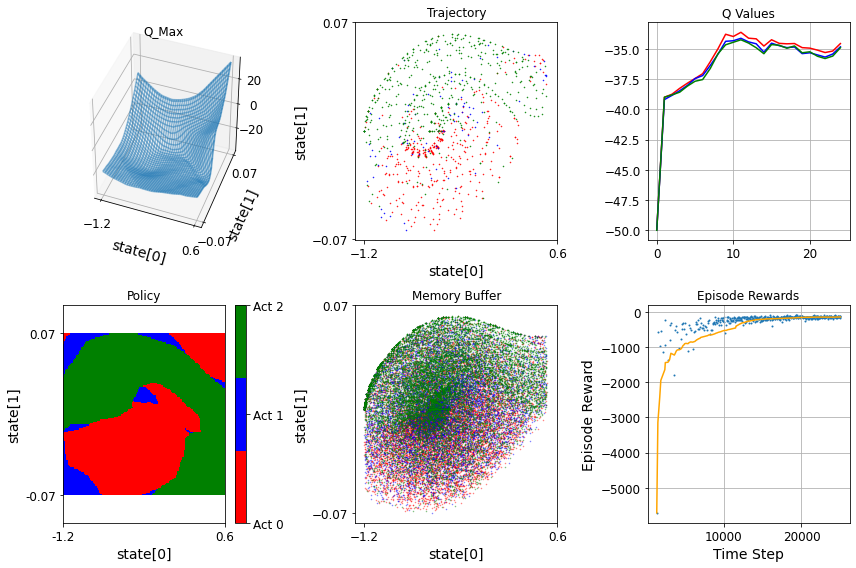

In [ ]:
#  plot the agent state
helpers.plot_all(env, model, mem, trace, print_=True)

> To Save weights

In [ ]:
# to save the weights with `ckpt` extention
model._model.save('./tf_models/MountainCar.ckpt')

> To Load weights

In [ ]:
model._model.load('./tf_models/MountainCar.ckpt')

INFO:tensorflow:Restoring parameters from ./tf_models/MountainCar.ckpt


> Now show the animation:

In [ ]:
def update_scene(num, frames, patch):
    patch.set_data(frames[num])
    return patch,

def plot_animation(frames, repeat=False, interval=40):
    fig = plt.figure()
    patch = plt.imshow(frames[0])
    plt.axis('off')
    anim = animation.FuncAnimation(
        fig, update_scene, fargs=(frames, patch),
        frames=len(frames), repeat=repeat, interval=interval)
    plt.close()
    return anim

> we will set `mode="rgb_array"` to get an image of the environment as a NumPy array:

In [ ]:
# build a list to save the image 
frames = []

for step in range(len(trace.actions)):
    img = env.render(mode="rgb_array")
    frames.append(img)
    action = trace.actions

    obs, reward, done, info = env.step(action[step])
    if done:
        break

In [ ]:
plot_animation(frames)

# **<a>Resources.</a>**

There are a lot of resources, but these are among the most important sources that helped me and I learned from them.

**Note:** The code sources were mentioned to each cell separately.



> [Intro to Reinforcement Learning](https://colab.research.google.com/github/tensorflow/agents/blob/master/docs/tutorials/0_intro_rl.ipynb#scrollTo=b5tItHFpLyXG)

> [Reinforcement Q-learning](https://colab.research.google.com/github/pytorch/tutorials/blob/gh-pages/_downloads/reinforcement_q_learning.ipynb#scrollTo=bNJ12S_eVD8o)

> [ML recipe mountain car](https://github.com/neuro-inc/ml-recipe-mountain-car/blob/master/notebooks/mountain_car_dqn.ipynb)

> [DQN ClassicControl](https://marcinbogdanski.github.io/rl-sketchpad/Deep_Q_Network/1010_DQN_ClassicControl.html)










